In [1]:
!pip install scanpy
!pip install ipython
!pip install numpy

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import numpy as np
import pandas as pd
import scanpy as sc


sc.settings.verbosity = 3   

In [4]:
sc.settings.set_figure_params(dpi=300)

In [5]:
results_file = "/content/drive/MyDrive/SC/SCANPY/write/DENV_final.h5ad"

In [6]:
#denv positive datasets
data_denv8 = sc.read_10x_mtx('/content/drive/MyDrive/SC/SCANPY/data/GSM4670196_Subject2_D8/', cache=True)
data_denv8.var_names_make_unique()
data_denv10 = sc.read_10x_mtx('/content/drive/MyDrive/SC/SCANPY/data/GSM4670197_Subject2_D10/', cache=True)
data_denv10.var_names_make_unique()
data_denv15 = sc.read_10x_mtx('/content/drive/MyDrive/SC/SCANPY/data/GSM4670198_Subject2_D15/', cache=True)
data_denv15.var_names_make_unique()
data_denv28 = sc.read_10x_mtx('/content/drive/MyDrive/SC/SCANPY/data/GSM4670199_Subject2_D28/', cache=True)
data_denv28.var_names_make_unique()

#control data set
data_ctrl3 = sc.read_10x_mtx('/content/drive/MyDrive/SC/SCANPY/data/GSM4670216_Natural1_Dneg3/', cache=True)
data_ctrl3.var_names_make_unique()
data_ctrl2 = sc.read_10x_mtx('/content/drive/MyDrive/SC/SCANPY/data/GSM4670217_Natural1_Dneg2/', cache=True)
data_ctrl2.var_names_make_unique()
data_ctrl4 = sc.read_10x_mtx('/content/drive/MyDrive/SC/SCANPY/data/GSM4670220_Natural2_Dneg4/', cache=True)
data_ctrl4.var_names_make_unique()
data_ctrl5 = sc.read_10x_mtx('/content/drive/MyDrive/SC/SCANPY/data/GSM4670219_Natural2_Dneg5/', cache=True)
data_ctrl5.var_names_make_unique()




... reading from cache file cache/content-drive-MyDrive-SC-SCANPY-data-GSM4670196_Subject2_D8-matrix.h5ad
... reading from cache file cache/content-drive-MyDrive-SC-SCANPY-data-GSM4670197_Subject2_D10-matrix.h5ad
... reading from cache file cache/content-drive-MyDrive-SC-SCANPY-data-GSM4670198_Subject2_D15-matrix.h5ad
... reading from cache file cache/content-drive-MyDrive-SC-SCANPY-data-GSM4670199_Subject2_D28-matrix.h5ad
... reading from cache file cache/content-drive-MyDrive-SC-SCANPY-data-GSM4670216_Natural1_Dneg3-matrix.h5ad
... reading from cache file cache/content-drive-MyDrive-SC-SCANPY-data-GSM4670217_Natural1_Dneg2-matrix.h5ad
... reading from cache file cache/content-drive-MyDrive-SC-SCANPY-data-GSM4670220_Natural2_Dneg4-matrix.h5ad
... reading from cache file cache/content-drive-MyDrive-SC-SCANPY-data-GSM4670219_Natural2_Dneg5-matrix.h5ad


In [7]:
# add some metadata
data_denv8.obs['type']="dengue"
data_denv8.obs['sample']="denv_8"
data_denv10.obs['type']="dengue"
data_denv10.obs['sample']="denv_10"
data_denv15.obs['type']="dengue"
data_denv15.obs['sample']="denv_15"
data_denv28.obs['type']="dengue"
data_denv28.obs['sample']="denv_28"



data_ctrl5.obs['type']="Ctrl"
data_ctrl5.obs['sample']="ctrl_5"
data_ctrl4.obs['type']="Ctrl"
data_ctrl4.obs['sample']="ctrl_4"
data_ctrl3.obs['type']="Ctrl"
data_ctrl3.obs['sample']="ctrl_3"
data_ctrl2.obs['type']="Ctrl"
data_ctrl2.obs['sample']="ctrl_2"


# merge into one object.
adata = data_denv10.concatenate(data_denv8, data_denv15, data_denv28, data_ctrl5,data_ctrl4, data_ctrl3, data_ctrl2)

# and delete individual datasets to save space
del(data_denv10, data_denv15, data_denv28)
del(data_ctrl5, data_ctrl3, data_ctrl2)

In [8]:
print(adata.obs['sample'].value_counts())

adata

denv_28    9763
denv_10    8971
denv_8     8691
denv_15    5231
ctrl_2     3950
ctrl_5     3651
ctrl_4     3349
ctrl_3     2175
Name: sample, dtype: int64


AnnData object with n_obs × n_vars = 45781 × 33694
    obs: 'type', 'sample', 'batch'
    var: 'gene_ids'

# Calculate QC

In [9]:
# mitochondrial genes
adata.var['mt'] = adata.var_names.str.startswith('MT-') 
# ribosomal genes
adata.var['ribo'] = adata.var_names.str.startswith(("RPS","RPL"))
# hemoglobin genes.
adata.var['hb'] = adata.var_names.str.contains(("^HB[^(P)]"))

adata.var

,gene_ids,mt,ribo,hb
RP11-34P13.3,ENSG00000243485,False,False,False
FAM138A,ENSG00000237613,False,False,False
OR4F5,ENSG00000186092,False,False,False
RP11-34P13.7,ENSG00000238009,False,False,False
RP11-34P13.8,ENSG00000239945,False,False,False
...,...,...,...,...
AC233755.2,ENSG00000277856,False,False,False
AC233755.1,ENSG00000275063,False,False,False
AC240274.1,ENSG00000271254,False,False,False
AC213203.1,ENSG00000277475,False,False,False


In [10]:
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt','ribo','hb'], percent_top=None, log1p=False, inplace=True)

In [11]:
mito_genes = adata.var_names.str.startswith('MT-')
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
adata.obs['percent_mt2'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = adata.X.sum(axis=1).A1

In [12]:
adata

AnnData object with n_obs × n_vars = 45781 × 33694
    obs: 'type', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

... storing 'type' as categorical
... storing 'sample' as categorical


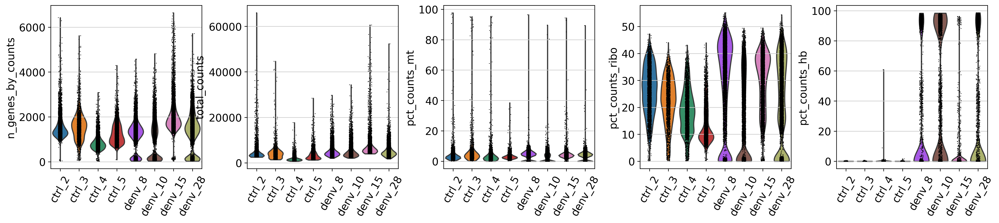

In [13]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo', 'pct_counts_hb'],jitter=0.1, groupby = 'sample', rotation= 60, save="qs.png")

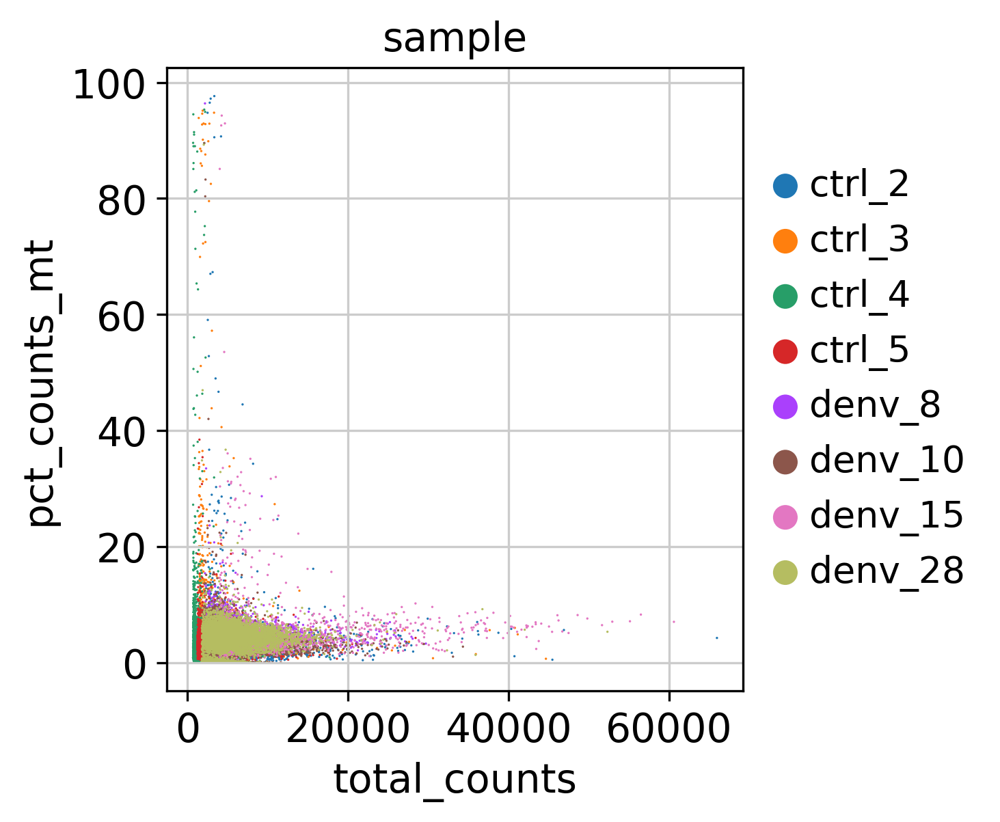

In [14]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', color="sample", save="scatter.png")

# Filtering

In [15]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

print(adata.n_obs, adata.n_vars)

filtered out 7858 cells that have less than 200 genes expressed
filtered out 11891 genes that are detected in less than 3 cells


37923 21803


normalizing counts per cell
    finished (0:00:00)


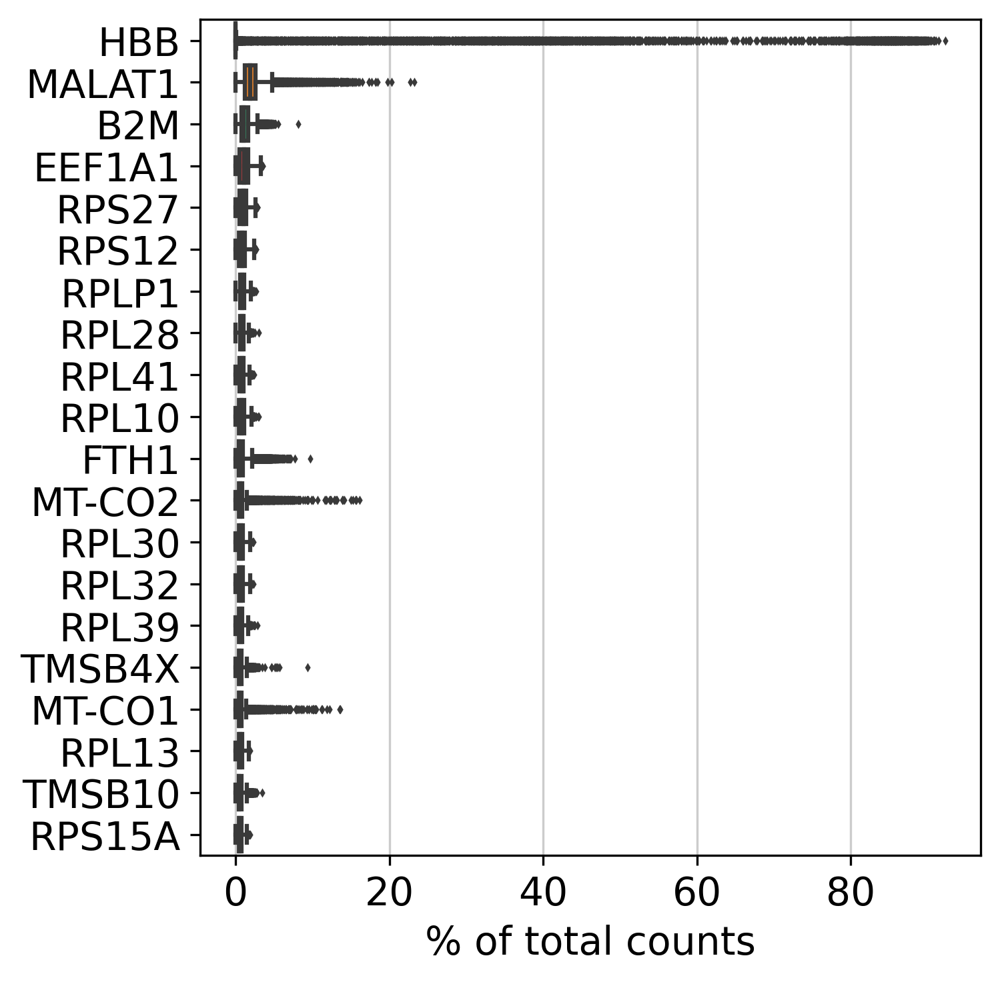

In [16]:
sc.pl.highest_expr_genes(adata, n_top=20, save="topgenes.png")

# Mito/Ribo filtering

In [17]:
# filter for percent mito


adata = adata[adata.obs['pct_counts_mt'] < 20, :]

# filter for percent ribo > 0.05
adata = adata[adata.obs['pct_counts_ribo'] > 5, :]

print("Remaining cells %d"%adata.n_obs)

Remaining cells 36718


# Plot filtered QC

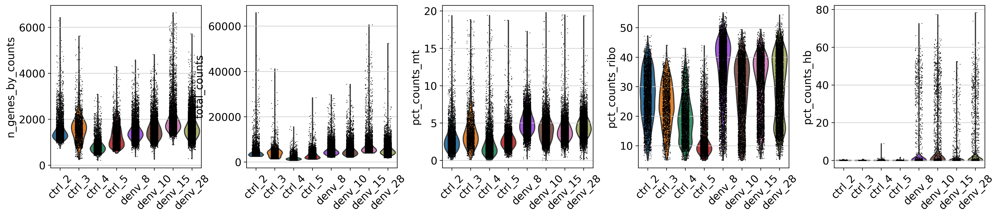

In [18]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt','pct_counts_ribo', 'pct_counts_hb'],jitter=0.2, groupby = 'sample', rotation = 45, save="_final_violin.png")

# FIlter genes

In [19]:
malat1 = adata.var_names.str.startswith('MALAT1')
# we need to redefine the mito_genes since they were first 
# calculated on the full object before removing low expressed genes.
mito_genes = adata.var_names.str.startswith('MT-')
hb_genes = adata.var_names.str.contains('^HB[^(P)]')

remove = np.add(mito_genes, malat1)
remove = np.add(remove, hb_genes)
keep = np.invert(remove)

adata = adata[:,keep]

print(adata.n_obs, adata.n_vars)

36718 21777


Remove cells that have too many mitochondrial genes expressed or too many total counts:

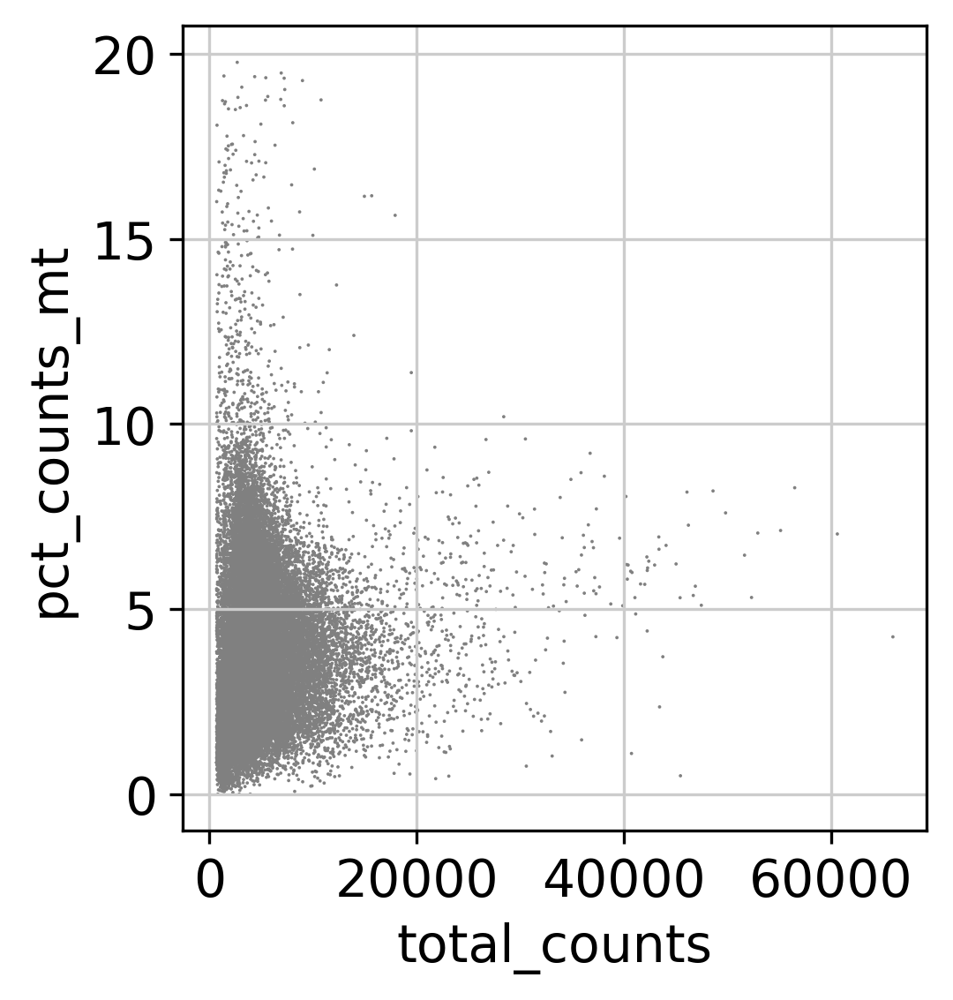

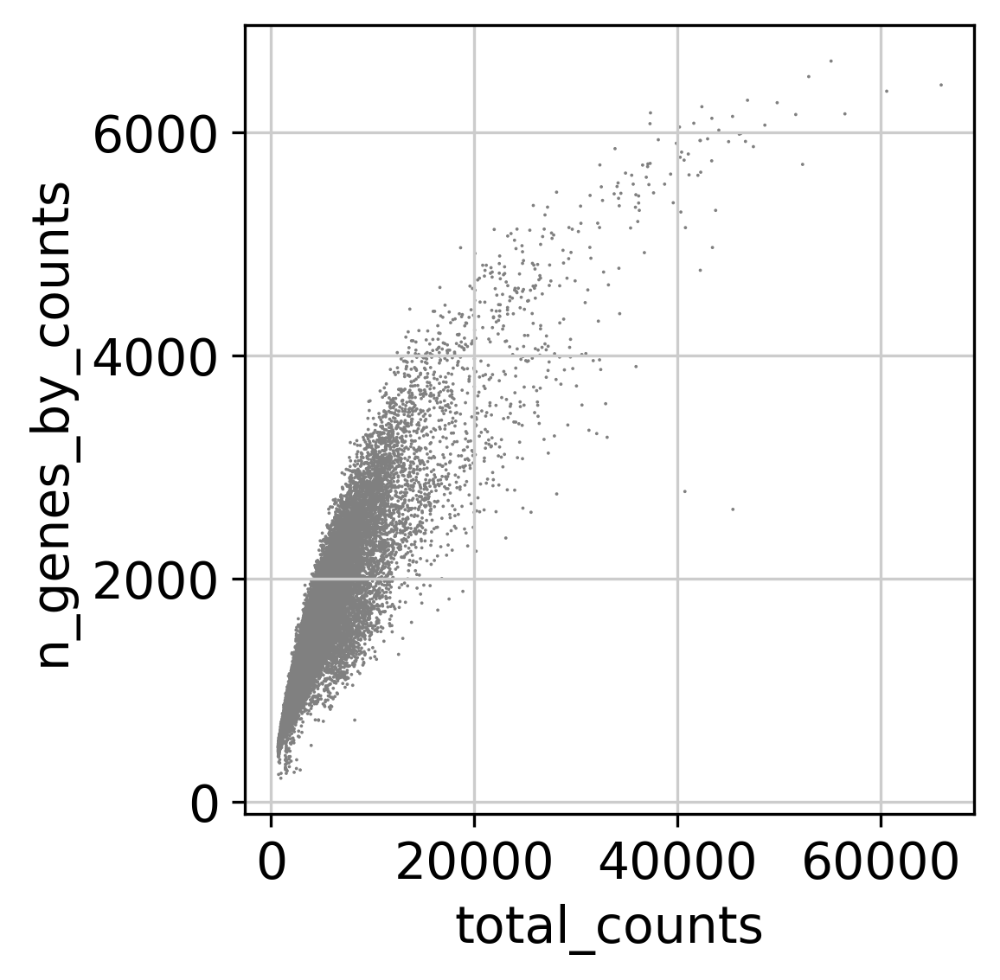

In [20]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', save="sct.png")
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', save="sca.png")

Actually do the filtering by slicing the AnnData object.

In [21]:
adata = adata[adata.obs.n_genes_by_counts < 2500, :]
adata = adata[adata.obs.pct_counts_mt < 5, :]

Total-count normalize (library-size correct) the data matrix X to 10,000 reads per cell, so that counts become comparable among cells.

In [22]:
sc.pp.normalize_total(adata, target_sum=1e4)

/usr/local/lib/python3.7/dist-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
normalizing counts per cell
    finished (0:00:00)


Logarithmize the data:

In [23]:
sc.pp.log1p(adata)

Identify highly-variable genes.

In [24]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


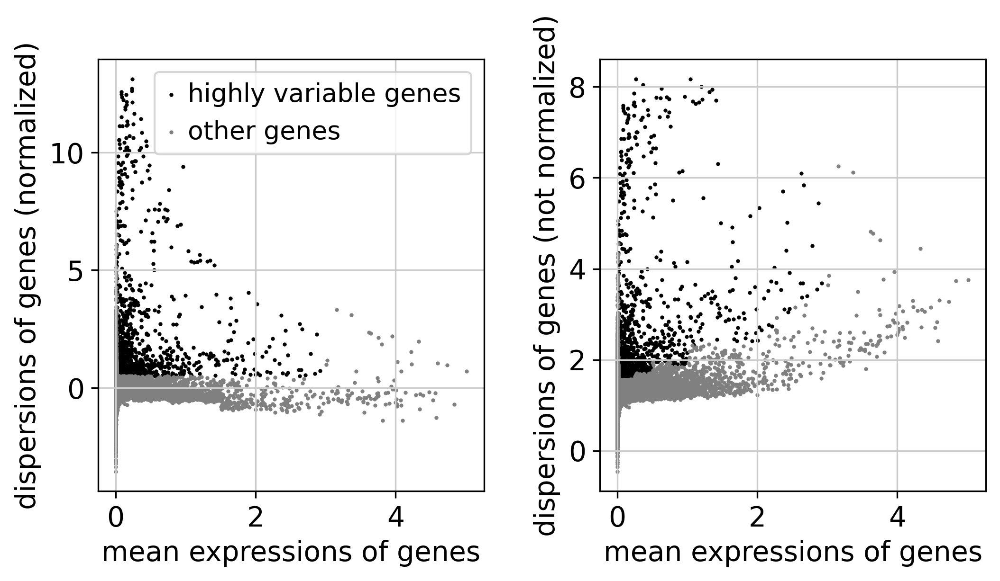

In [25]:
sc.pl.highly_variable_genes(adata, save="_highly_variable_genes.png")

Set the .raw attribute of the AnnData object to the normalized and logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. This simply freezes the state of the AnnData object.You can get back an AnnData of the object in .raw by calling .raw.to_adata().

In [26]:
adata.raw = adata

In [27]:
adata = adata[:, adata.var.highly_variable]

Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.

In [28]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
    finished (0:00:35)


Scale each gene to unit variance. Clip values exceeding standard deviation 10.

In [29]:
sc.pp.scale(adata, max_value=10)

# Principal component analysis

Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.



In [30]:
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)


We can make a scatter plot in the PCA coordinates, but we will not use that later on.

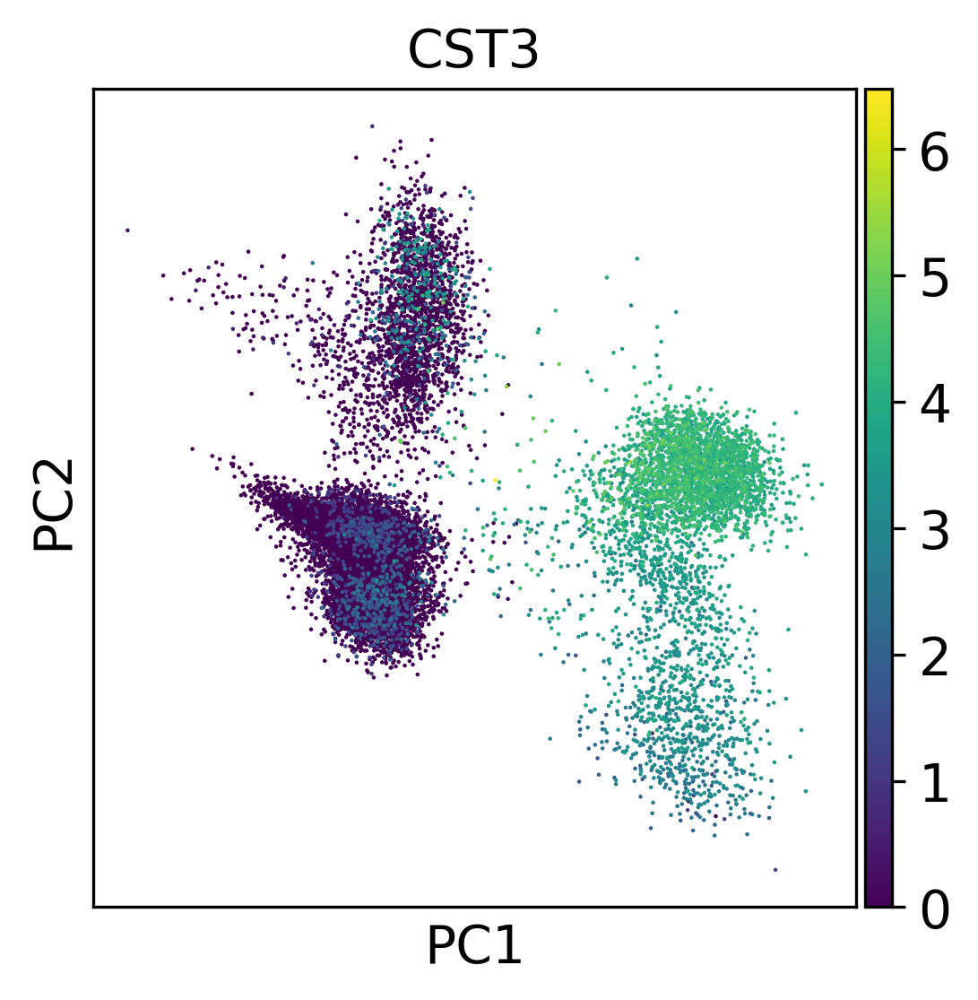

In [31]:
sc.pl.pca(adata, color='CST3', save="_scatter_plot.png")

Let us inspect the contribution of single PCs to the total variance in the data. This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function sc.tl.louvain() or tSNE sc.tl.tsne(). In our experience, often a rough estimate of the number of PCs does fine.

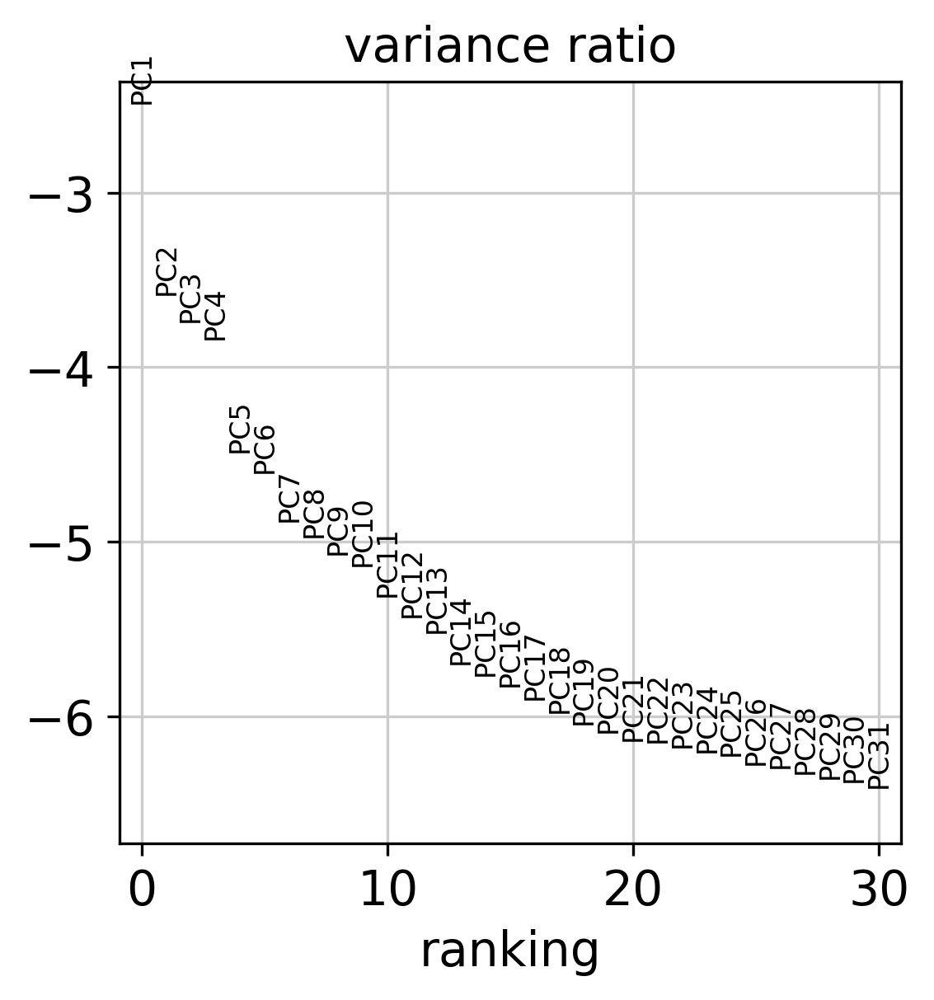

In [32]:
sc.pl.pca_variance_ratio(adata, log=True, save="_variace_ration.png")

In [33]:
adata.write(results_file)

In [34]:
adata

AnnData object with n_obs × n_vars = 25279 × 1263
    obs: 'type', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'sample_colors', 'log1p', 'hvg', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

# Computing the neighborhood graph

In [35]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:45)


# Embedding the neighborhood graph

>tl.paga(adata)
>pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
>tl.umap(adata, init_pos='paga')

In [36]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:33)


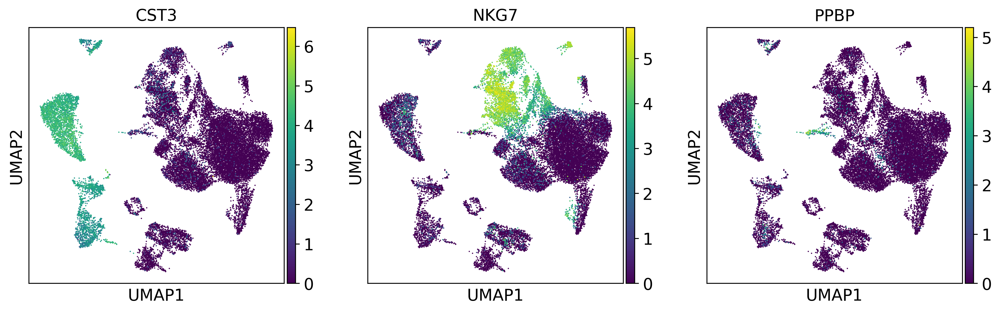

In [37]:
sc.pl.umap(adata, color=['CST3', 'NKG7', 'PPBP'], save="_umap.png")

As we set the .raw attribute of adata, the previous plots showed the “raw” (normalized, logarithmized, but uncorrected) gene expression. You can also plot the scaled and corrected gene expression by explicitly stating that you don’t want to use .raw.

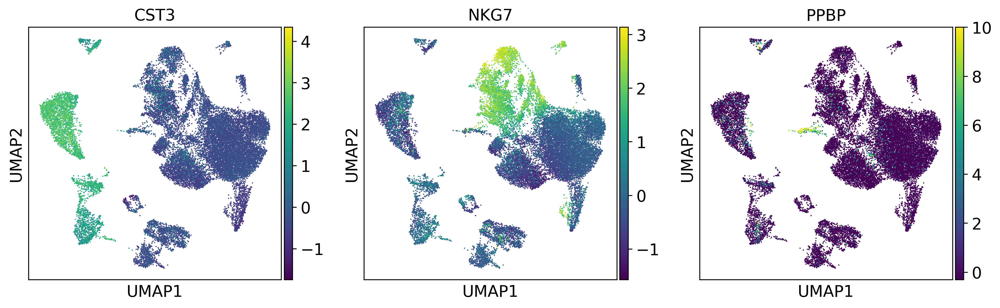

In [38]:
sc.pl.umap(adata, color=['CST3', 'NKG7', 'PPBP'], use_raw=False, save="_nonwar_umap.png")

# Clustering the neighborhood graph

In [39]:
!pip3 install leidenalg

In [40]:
sc.tl.leiden(adata)

running Leiden clustering
    finished: found 22 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:04)


Plot the clusters, which agree quite well with the result of Seurat.

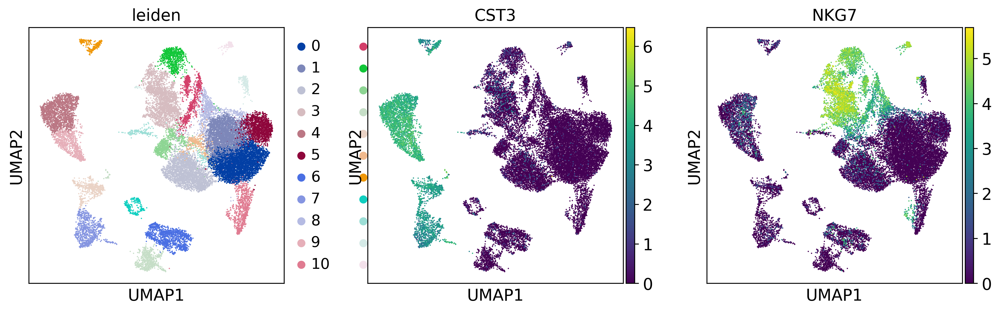

In [41]:
sc.pl.umap(adata, color=['leiden', 'CST3', 'NKG7'], save="_leiden.png")

Save the result.

In [42]:
adata.write(results_file)

# Finding marker genes

Let us compute a ranking for the highly differential genes in each cluster. For this, by default, the .raw attribute of AnnData is used in case it has been initialized before. The simplest and fastest method to do so is the t-test.

In [43]:
sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, save="_ranking_gene.png")


Output hidden; open in https://colab.research.google.com to view.

In [44]:
sc.settings.verbosity = 2  # reduce the verbosity

The result of a Wilcoxon rank-sum (Mann-Whitney-U) test is very similar. We recommend using the latter in publications, see e.g., Sonison & Robinson (2018). You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.

In [45]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, save="_ranking_verboise_2.png")

Output hidden; open in https://colab.research.google.com to view.

In [46]:
#saving the result
adata.write(results_file)

Let us also define a list of marker genes for later reference.

In [47]:
marker_genes = ['IL7R', 'CD79A', 'MS4A1', 'CD8A', 'CD8B', 'LYZ', 'CD14',
                'LGALS3', 'S100A8', 'GNLY', 'NKG7', 'KLRB1',
                'FCGR3A', 'MS4A7', 'FCER1A', 'CST3', 'PPBP']

Reload the object that has been save with the Wilcoxon Rank-Sum test result.

In [48]:
adata = sc.read(results_file)

Show the 10 top ranked genes per cluster 0, 1, …, 7 in a dataframe.

In [49]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(5)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21
0,RPS3A,ANXA1,AC090498.1,NKG7,S100A8,CD8B,MS4A1,IL1B,DUSP2,LST1,SLC25A37,CCL5,GNLY,RP11-291B21.2,HLA-DRA,FTH1,FOXP3,PLD4,MZB1,PPBP,TRBV7-6,TRBV14
1,RPS13,RGCC,RPS4Y1,CST7,LYZ,RPS3A,CD79A,SOD2,EZR,IFI30,SLC25A39,NKG7,NKG7,CD8B,CD74,C5AR1,IL32,ITM2C,JCHAIN,SDPR,TRBV7-4,GNLY
2,RPS27A,LMNA,TMSB4X,PRF1,S100A9,RPS12,CD74,CXCL8,CREM,APOBEC3A,SNCA,KLRB1,CTSW,RPS4Y1,HLA-DQB1,NAMPT,BIRC3,LILRA4,SSR4,NRGN,TRBV7-9,TRGV5
3,RPL30,EZR,TXNIP,GZMH,FCN1,CCR7,HLA-DQA2,CCL3L3,SRSF2,SERPINA1,BNIP3L,CST7,GZMB,AC090498.1,HLA-DQA1,NEAT1,PBXIP1,SEC61B,PPIB,TUBB1,TRBV7-2,PRF1
4,RPS26,PABPC1,RPL26,CCL5,IFITM3,RPS4X,HLA-DRA,CCL3,LDHA,LILRB2,ADIPOR1,IL32,REL,CD3E,HLA-DPB1,SLC11A1,ARHGDIB,IRF8,HSP90B1,PF4,TRBV7-7,GZMB


In [50]:
pd.DataFrame(adata.uns['rank_genes_groups']['names'])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21
0,RPS3A,ANXA1,AC090498.1,NKG7,S100A8,CD8B,MS4A1,IL1B,DUSP2,LST1,SLC25A37,CCL5,GNLY,RP11-291B21.2,HLA-DRA,FTH1,FOXP3,PLD4,MZB1,PPBP,TRBV7-6,TRBV14
1,RPS13,RGCC,RPS4Y1,CST7,LYZ,RPS3A,CD79A,SOD2,EZR,IFI30,SLC25A39,NKG7,NKG7,CD8B,CD74,C5AR1,IL32,ITM2C,JCHAIN,SDPR,TRBV7-4,GNLY
2,RPS27A,LMNA,TMSB4X,PRF1,S100A9,RPS12,CD74,CXCL8,CREM,APOBEC3A,SNCA,KLRB1,CTSW,RPS4Y1,HLA-DQB1,NAMPT,BIRC3,LILRA4,SSR4,NRGN,TRBV7-9,TRGV5
3,RPL30,EZR,TXNIP,GZMH,FCN1,CCR7,HLA-DQA2,CCL3L3,SRSF2,SERPINA1,BNIP3L,CST7,GZMB,AC090498.1,HLA-DQA1,NEAT1,PBXIP1,SEC61B,PPIB,TUBB1,TRBV7-2,PRF1
4,RPS26,PABPC1,RPL26,CCL5,IFITM3,RPS4X,HLA-DRA,CCL3,LDHA,LILRB2,ADIPOR1,IL32,REL,CD3E,HLA-DPB1,SLC11A1,ARHGDIB,IRF8,HSP90B1,PF4,TRBV7-7,GZMB
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21772,H3F3B,TXNIP,MYADM,VIM,RPS23,PFN1,CD3E,RPS27,LY6E,RPS27A,TXNIP,FOXP1,CD3E,S100A11,MT2A,RPS3,DUSP1,GIMAP7,RPL32,TMSB10,TYROBP,RPS13
21773,CYBA,IFITM2,EZR,EEF1A1,RPS3,HLA-B,FYB,RPS29,SELL,RPS3,IFITM3,RPS13,RPS12,RPS26,FYB,CD3E,FOS,ARHGDIB,RPS12,HLA-DRB1,CD74,RPL39
21774,HLA-B,ISG15,RPS26,RPS13,RPL10,H3F3B,ANXA1,PTMA,IFI44L,RPS18,CYBA,H3F3A,AC090498.1,ANXA1,TMSB4X,RPS27,IFITM2,CD3E,FTH1,ISG15,HLA-DRB5,RPL28
21775,B2M,LY6E,FTH1,FTH1,RPS27,ACTB,VIM,RPL41,TXNIP,RPS15A,TMSB10,SELL,RPL28,SRGN,CD3E,RPS29,PLAC8,RPL28,RPS27,CD74,FTL,FTH1


Get a table with the scores and groups.

In [51]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(5)

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,5_n,5_p,6_n,6_p,7_n,7_p,8_n,8_p,9_n,9_p,10_n,10_p,11_n,11_p,12_n,12_p,13_n,13_p,14_n,14_p,15_n,15_p,16_n,16_p,17_n,17_p,18_n,18_p,19_n,19_p,20_n,20_p,21_n,21_p
0,RPS3A,0.0,ANXA1,0.0,AC090498.1,0.0,NKG7,0.0,S100A8,0.0,CD8B,0.0,MS4A1,0.0,IL1B,0.0,DUSP2,9.540527e-229,LST1,0.0,SLC25A37,0.0,CCL5,1.062558e-265,GNLY,0.000000e+00,RP11-291B21.2,2.261149e-229,HLA-DRA,0.0,FTH1,1.427812e-303,FOXP3,5.598864e-127,PLD4,1.314024e-161,MZB1,1.216405e-153,PPBP,4.862927e-97,TRBV7-6,9.027222e-109,TRBV14,3.767070e-71
1,RPS13,0.0,RGCC,0.0,RPS4Y1,0.0,CST7,0.0,LYZ,0.0,RPS3A,0.0,CD79A,0.0,SOD2,0.0,EZR,2.044544e-209,IFI30,0.0,SLC25A39,0.0,NKG7,8.915406e-253,NKG7,6.587020e-295,CD8B,1.367141e-211,CD74,0.0,C5AR1,6.456159e-284,IL32,1.782501e-76,ITM2C,1.213621e-155,JCHAIN,1.510993e-151,SDPR,1.862697e-70,TRBV7-4,1.693269e-106,GNLY,7.351353e-71
2,RPS27A,0.0,LMNA,0.0,TMSB4X,0.0,PRF1,0.0,S100A9,0.0,RPS12,0.0,CD74,0.0,CXCL8,0.0,CREM,3.216046e-204,APOBEC3A,0.0,SNCA,0.0,KLRB1,2.838339e-246,CTSW,3.017678e-294,RPS4Y1,4.902861e-204,HLA-DQB1,0.0,NAMPT,2.486426e-277,BIRC3,2.128362e-44,LILRA4,2.908906e-151,SSR4,1.117665e-125,NRGN,5.730679e-62,TRBV7-9,6.478723e-93,TRGV5,1.206123e-68
3,RPL30,0.0,EZR,0.0,TXNIP,0.0,GZMH,0.0,FCN1,0.0,CCR7,0.0,HLA-DQA2,0.0,CCL3L3,0.0,SRSF2,9.784710e-202,SERPINA1,0.0,BNIP3L,0.0,CST7,1.855751e-233,GZMB,6.743636e-289,AC090498.1,9.431100e-189,HLA-DQA1,0.0,NEAT1,1.435790e-270,PBXIP1,1.752274e-42,SEC61B,1.112556e-148,PPIB,2.263905e-122,TUBB1,1.053390e-57,TRBV7-2,1.873647e-80,PRF1,5.426203e-67
4,RPS26,0.0,PABPC1,0.0,RPL26,0.0,CCL5,0.0,IFITM3,0.0,RPS4X,0.0,HLA-DRA,0.0,CCL3,0.0,LDHA,1.701013e-198,LILRB2,0.0,ADIPOR1,0.0,IL32,1.907478e-217,REL,2.670356e-285,CD3E,6.721423e-154,HLA-DPB1,0.0,SLC11A1,4.227013e-255,ARHGDIB,3.129350e-39,IRF8,8.527087e-145,HSP90B1,6.002010e-118,PF4,2.823649e-53,TRBV7-7,4.378716e-70,GZMB,2.584731e-65


Compare to a single cluster:

ranking genes
    finished (0:00:10)


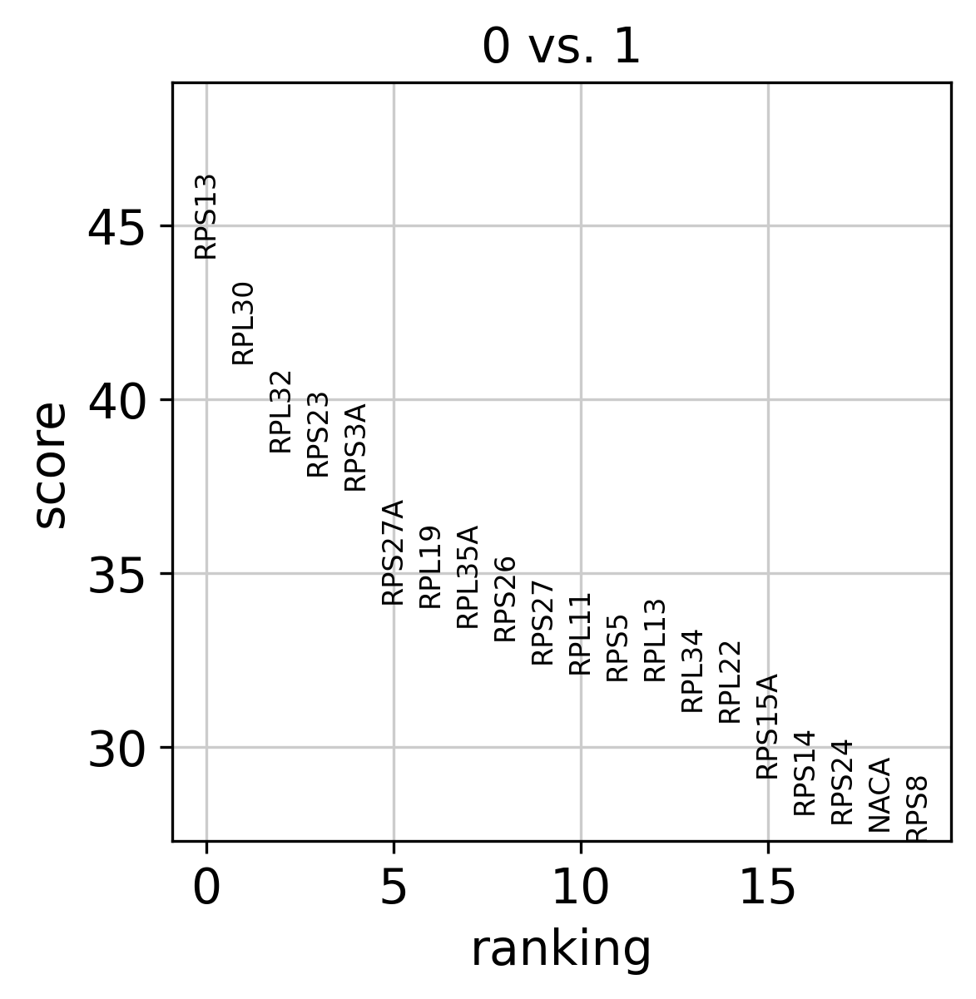

In [52]:
sc.tl.rank_genes_groups(adata, 'leiden', groups=['0'], reference='1', method='wilcoxon')
sc.pl.rank_genes_groups(adata, groups=['0'], n_genes=20, save="_compare_single_cluster.png")

If we want a more detailed view for a certain group, use sc.pl.rank_genes_groups_violin.

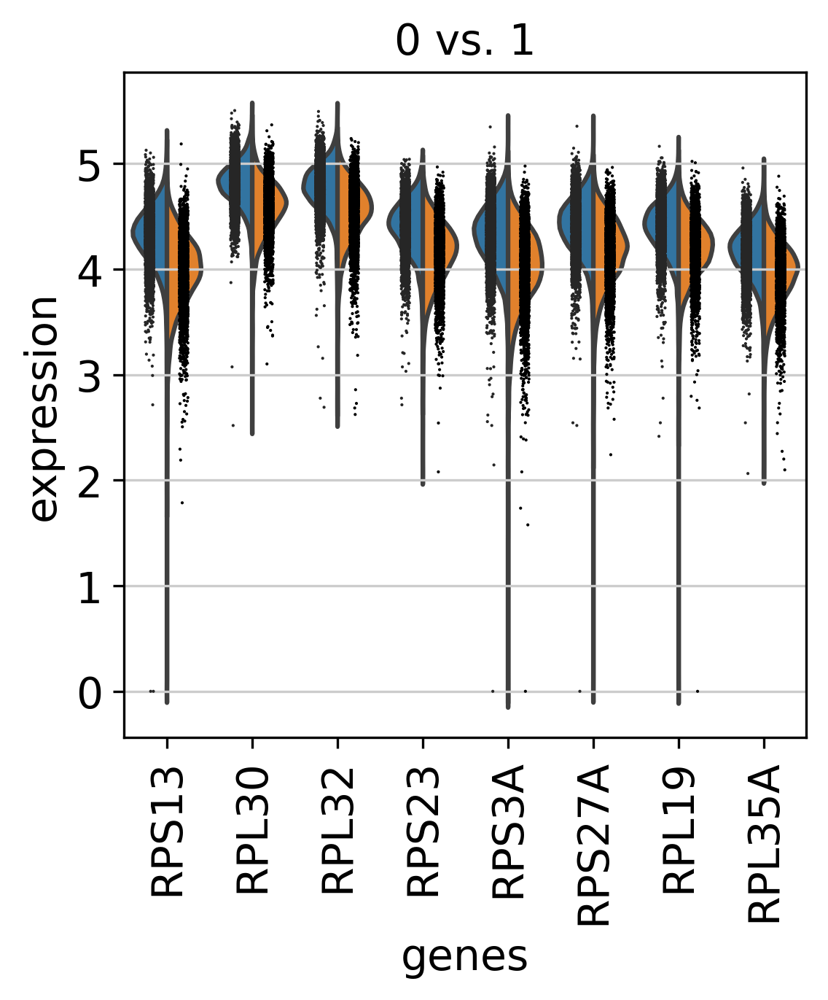

In [53]:
sc.pl.rank_genes_groups_violin(adata, groups='0', n_genes=8, save="_detail_single_cluster_info.png")

Reload the object with the computed differential expression (i.e. DE via a comparison with the rest of the groups):

In [54]:
adata = sc.read(results_file)

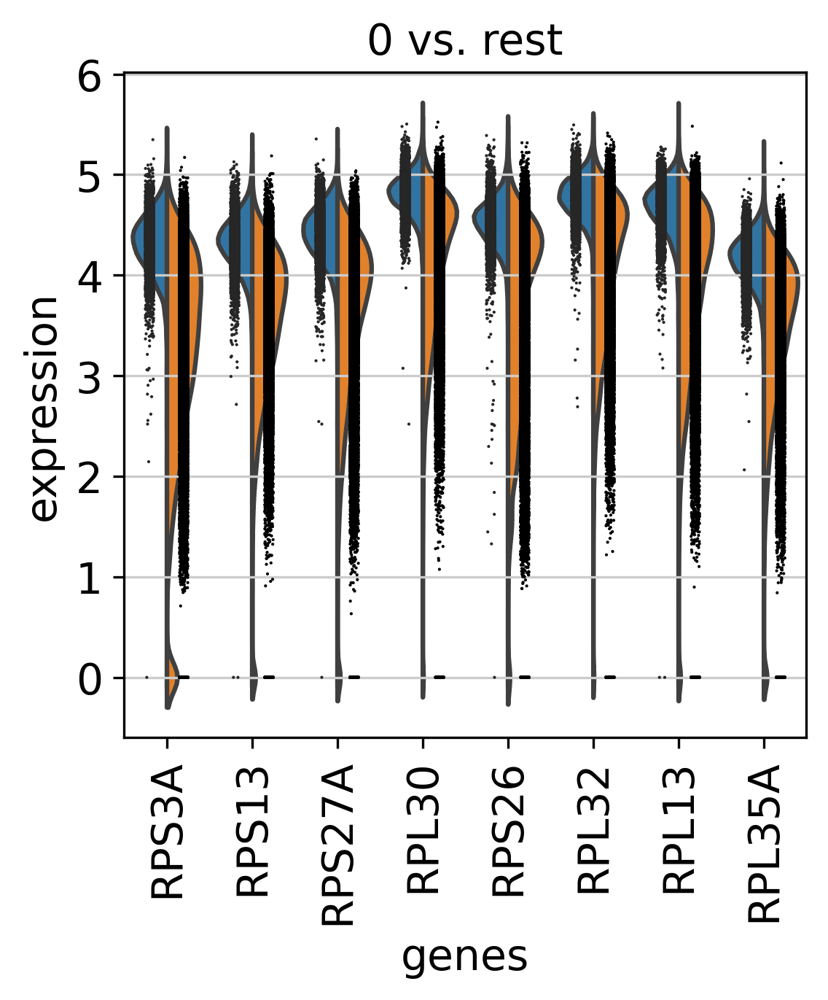

In [55]:
sc.pl.rank_genes_groups_violin(adata, groups='0', n_genes=8, save="_computed_DE.png")

If you want to compare a certain gene across groups, use the following.

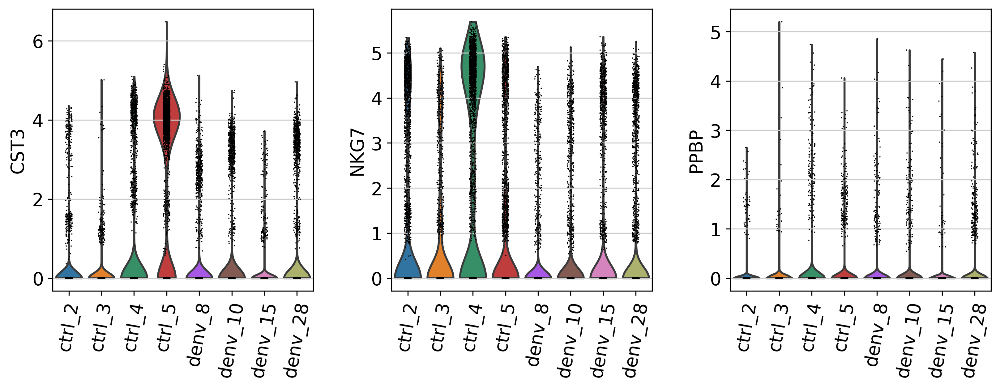

In [56]:
sc.pl.violin(adata, ['CST3', 'NKG7', 'PPBP'], groupby='sample', save="_compare_DE.png", rotation=80)

Actually mark the cell types.

In [57]:
new_cluster_names = [
    'CD4 T', 'CD14 Monocytes',
    'B', 'CD8 T',
    'NK', 'FCGR3A Monocytes',
    'Dendritic', 'Megakaryocytes']
adata.rename_categories('sample', new_cluster_names)

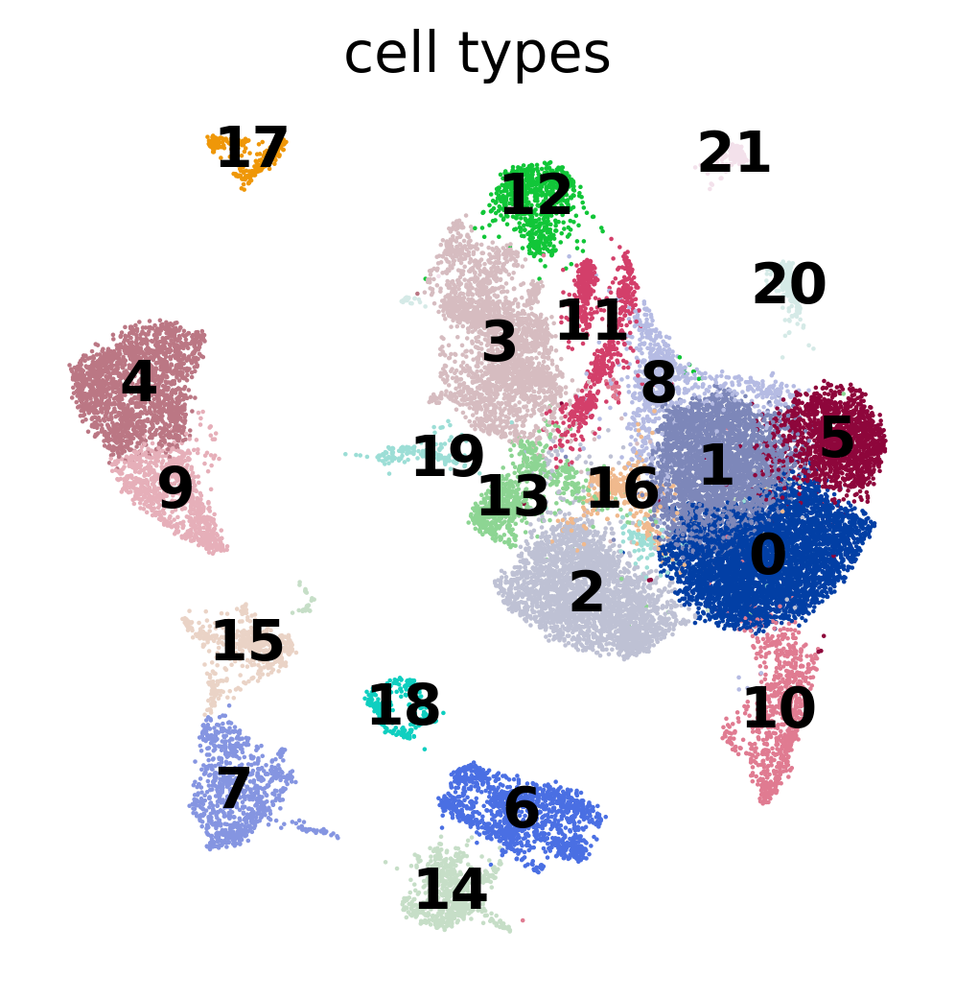

In [58]:
sc.pl.umap(adata, color='leiden', legend_loc='on data', title='cell types', frameon=False, save='_.png')

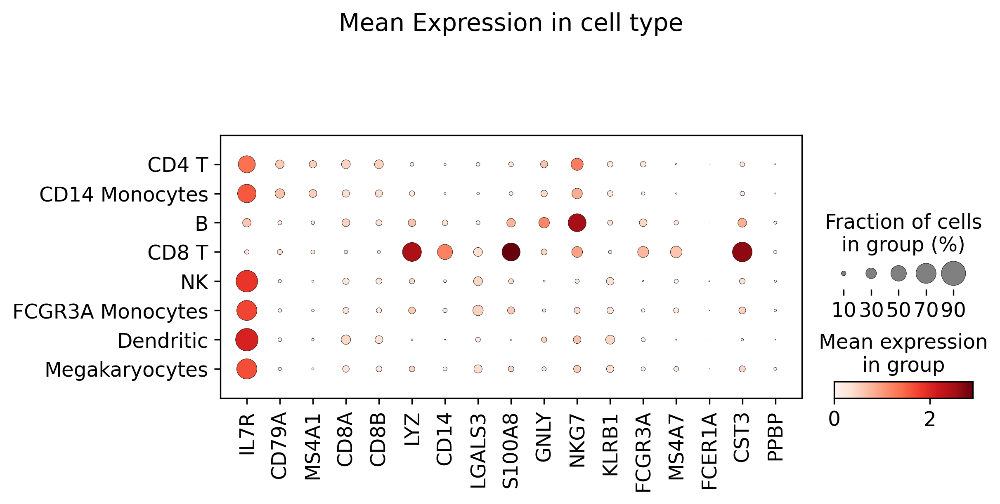

In [59]:
sc.pl.dotplot(adata, marker_genes, groupby='sample', save="_cell_type_mean_expression", title="Mean Expression in cell type")

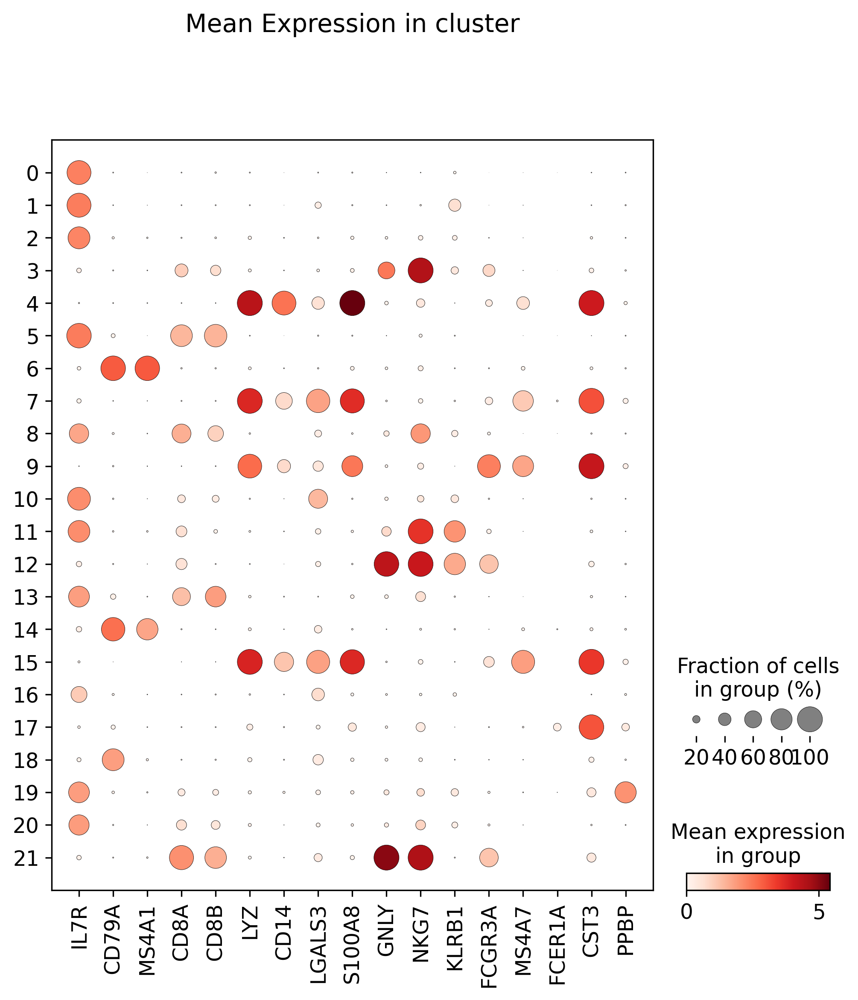

In [60]:
sc.pl.dotplot(adata, marker_genes, groupby='leiden', save="_cluster_mean_expression", title="Mean Expression in cluster")

There is also a very compact violin plot.


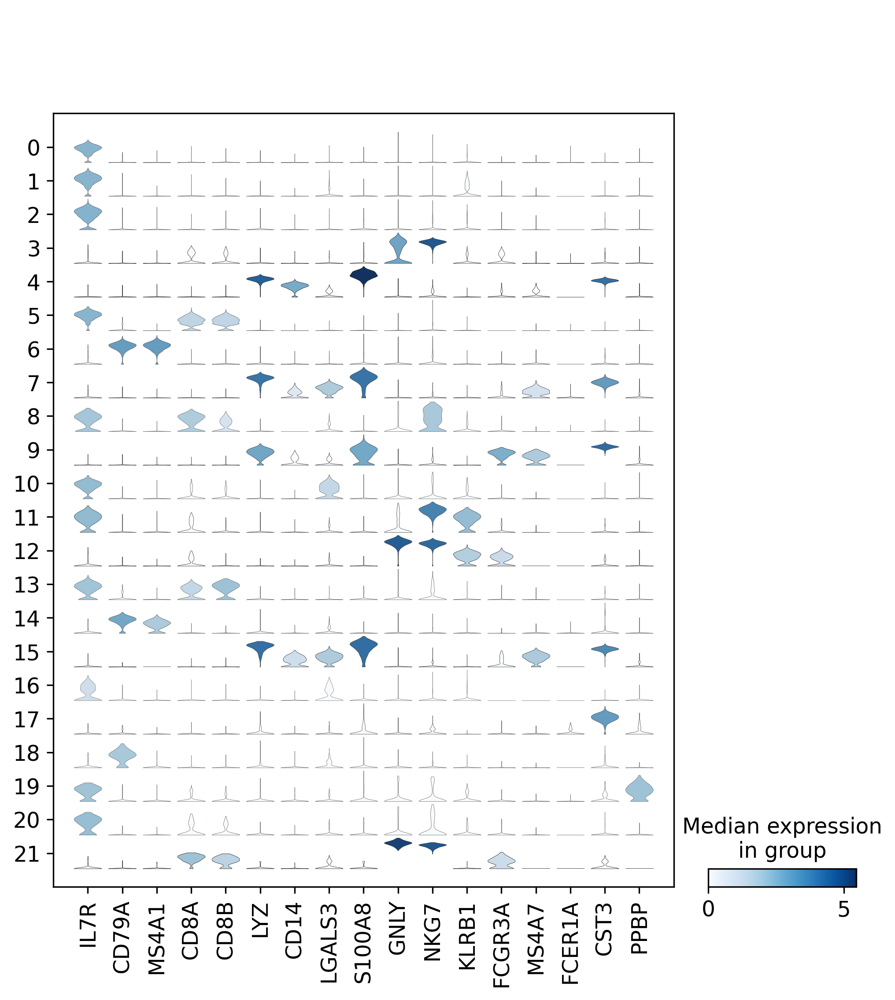

In [61]:
sc.pl.stacked_violin(adata, marker_genes, groupby='leiden', rotation=90, save="_violin.png");

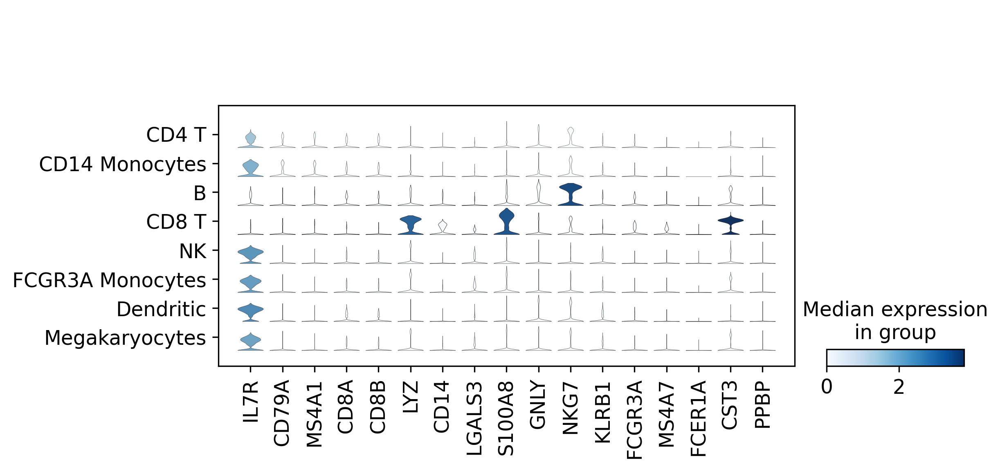

In [62]:
sc.pl.stacked_violin(adata, marker_genes, groupby='sample', rotation=90, save="_cell_tye_violin.png");

In [63]:
adata

AnnData object with n_obs × n_vars = 25279 × 1263
    obs: 'type', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'leiden'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [64]:
sc.tl.leiden(adata, key_added = "leiden_1.0") # default resolution in 1.0
sc.tl.leiden(adata, resolution = 0.6, key_added = "leiden_0.6")
sc.tl.leiden(adata, resolution = 0.4, key_added = "leiden_0.4")
sc.tl.leiden(adata, resolution = 1.4, key_added = "leiden_1.4")

running Leiden clustering
    finished (0:00:04)
running Leiden clustering
    finished (0:00:04)
running Leiden clustering
    finished (0:00:05)
running Leiden clustering
    finished (0:00:03)


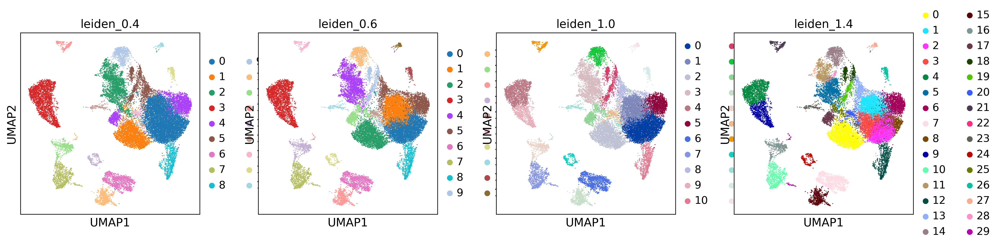

In [65]:
sc.pl.umap(adata, color=['leiden_0.4', 'leiden_0.6', 'leiden_1.0','leiden_1.4'], save="__leiden_umap.png")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_0.6']`


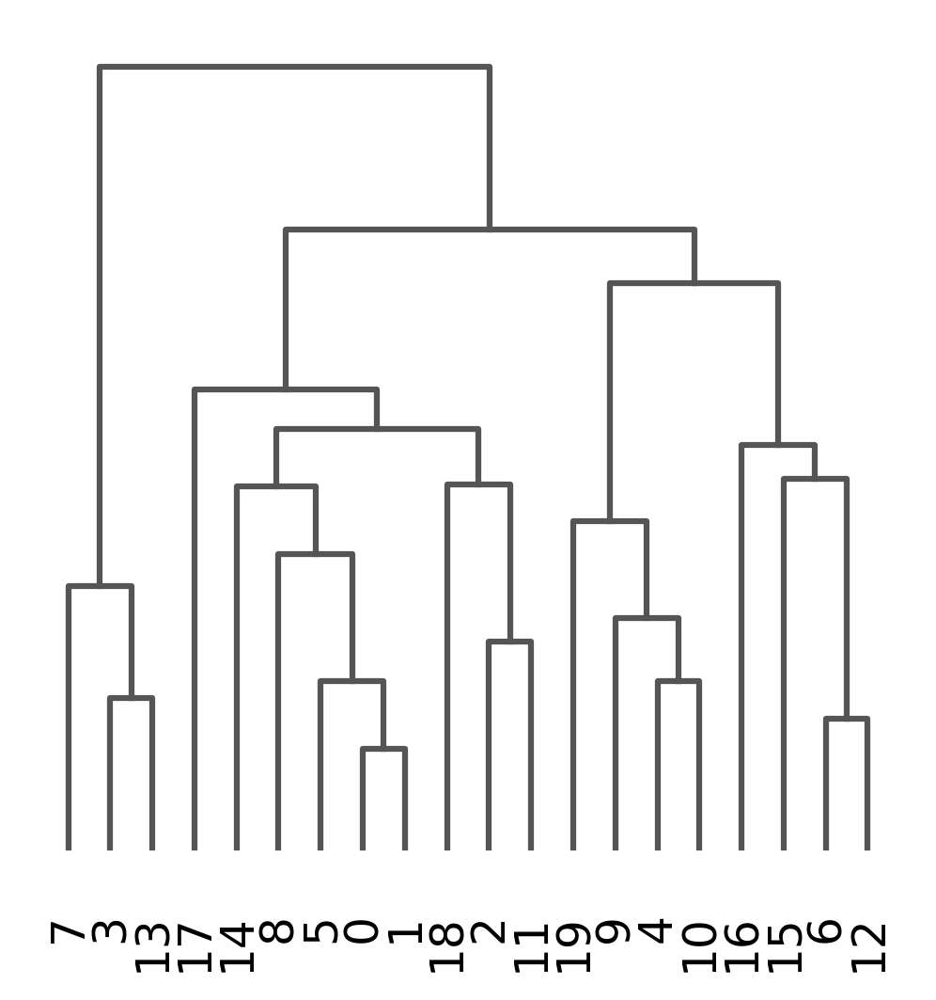

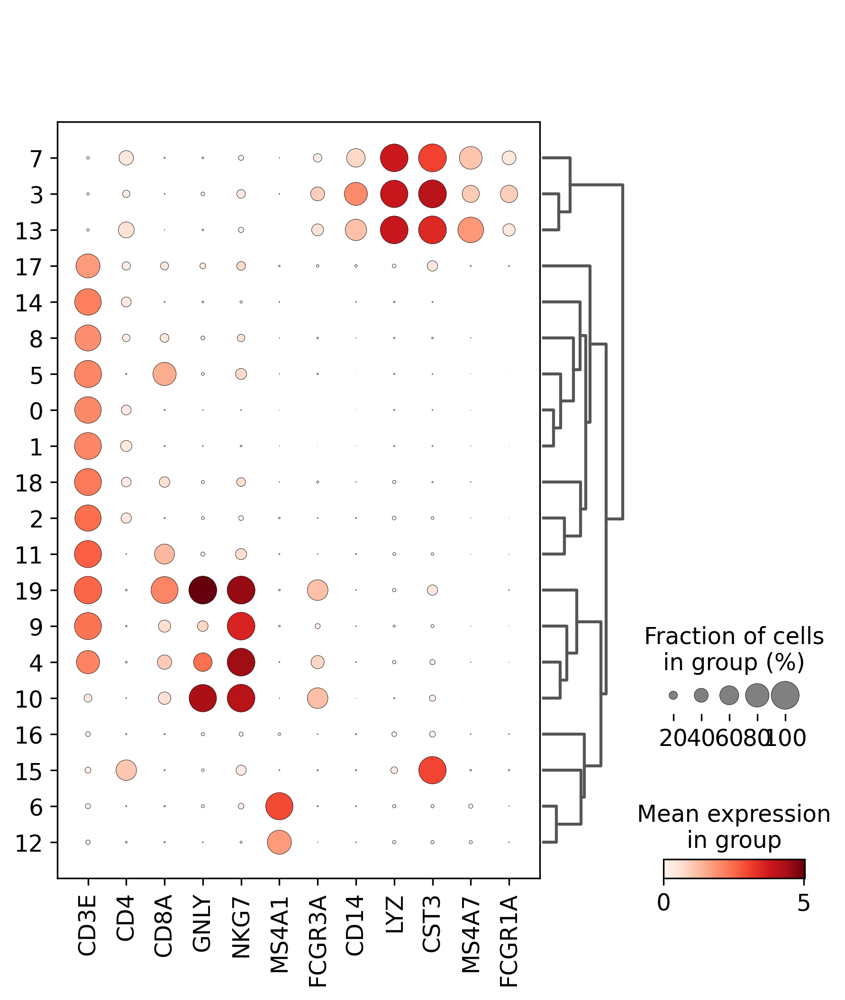

In [66]:
sc.tl.dendrogram(adata, groupby = "leiden_0.6")
sc.pl.dendrogram(adata, groupby = "leiden_0.6")

genes  = ["CD3E", "CD4", "CD8A", "GNLY","NKG7", "MS4A1","FCGR3A","CD14","LYZ","CST3","MS4A7","FCGR1A"]
sc.pl.dotplot(adata, genes, groupby='leiden_0.6', dendrogram=True, save="_dengogramp.png")

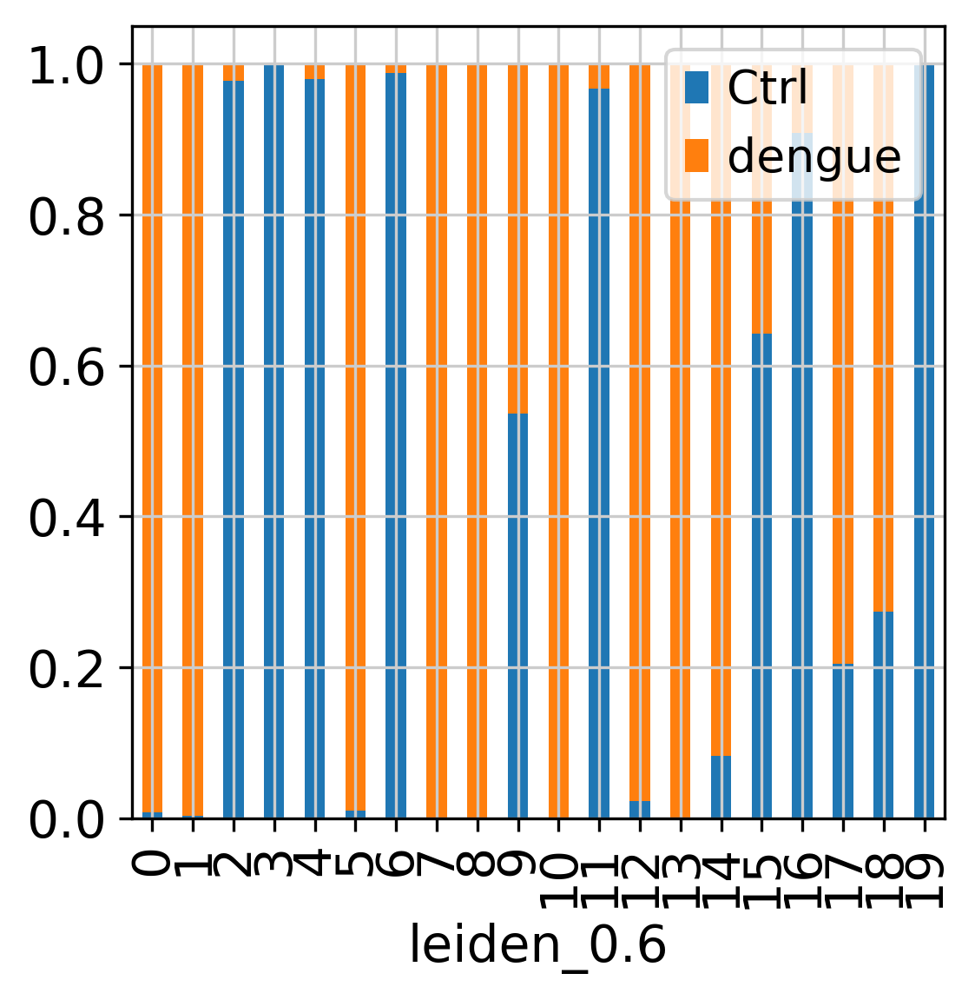

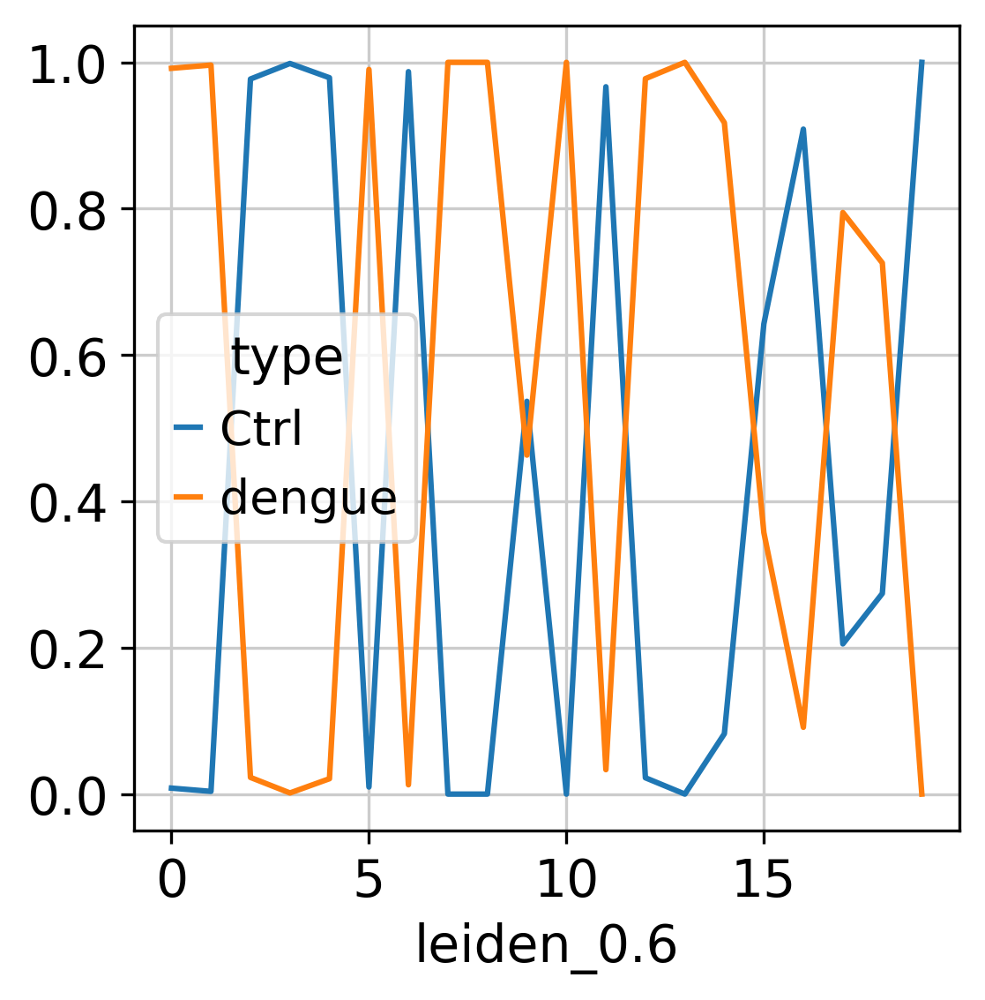

In [67]:
tmp = pd.crosstab(adata.obs['leiden_0.6'],adata.obs['type'], normalize='index')
tmp.plot.bar(stacked=True).legend(loc='upper right')
plot= tmp.plot()
fig = plot.get_figure()
fig.savefig("./figures/output.png")

In [68]:
!pip install louvain

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:04)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:04)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:04)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:04)


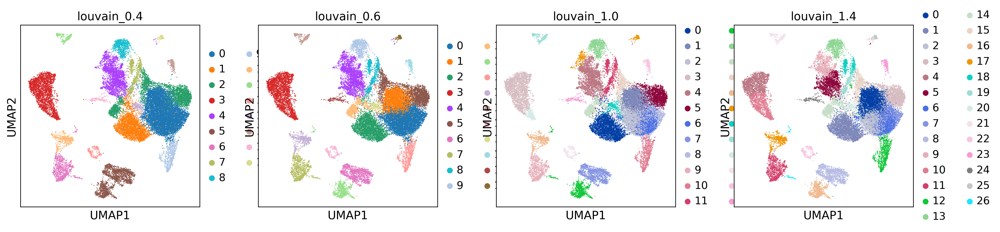

In [69]:
sc.tl.louvain(adata, key_added = "louvain_1.0") # default resolution in 1.0
sc.tl.louvain(adata, resolution = 0.6, key_added = "louvain_0.6")
sc.tl.louvain(adata, resolution = 0.4, key_added = "louvain_0.4")
sc.tl.louvain(adata, resolution = 1.4, key_added = "louvain_1.4")

sc.pl.umap(adata, color=['louvain_0.4', 'louvain_0.6', 'louvain_1.0','louvain_1.4'], save="_louvan.png")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain_0.6']`


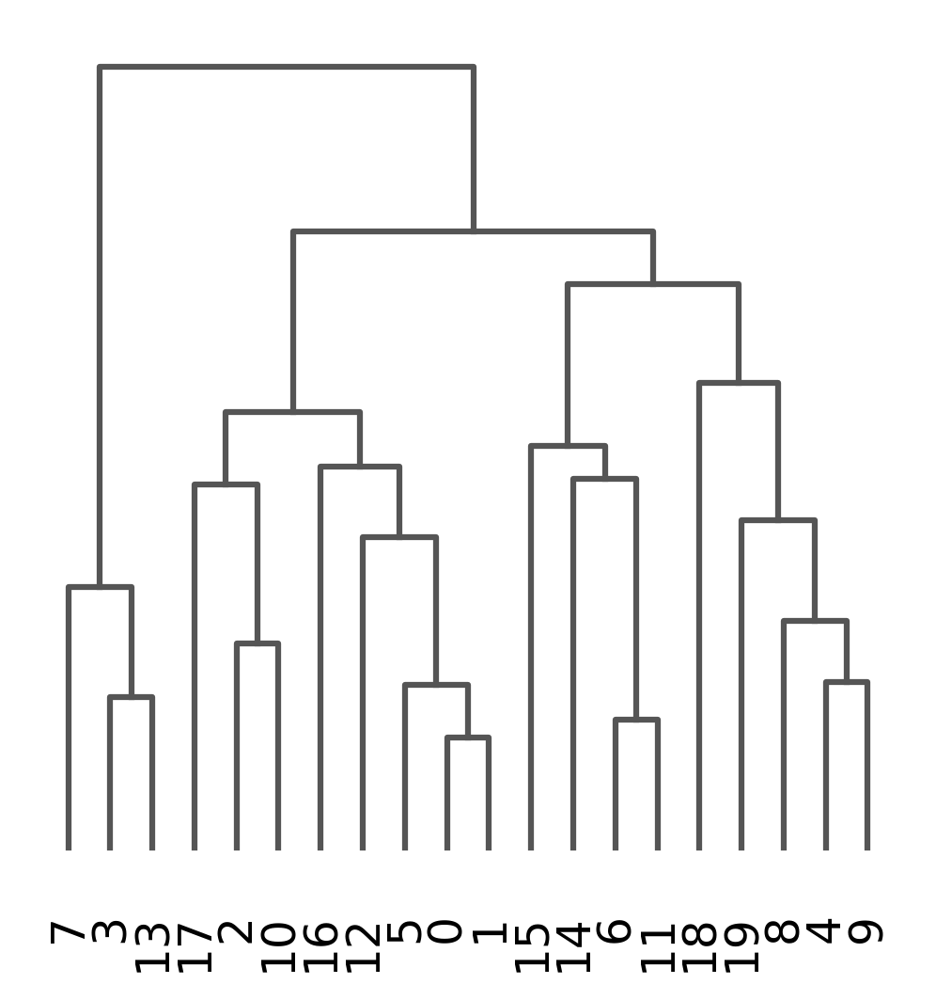

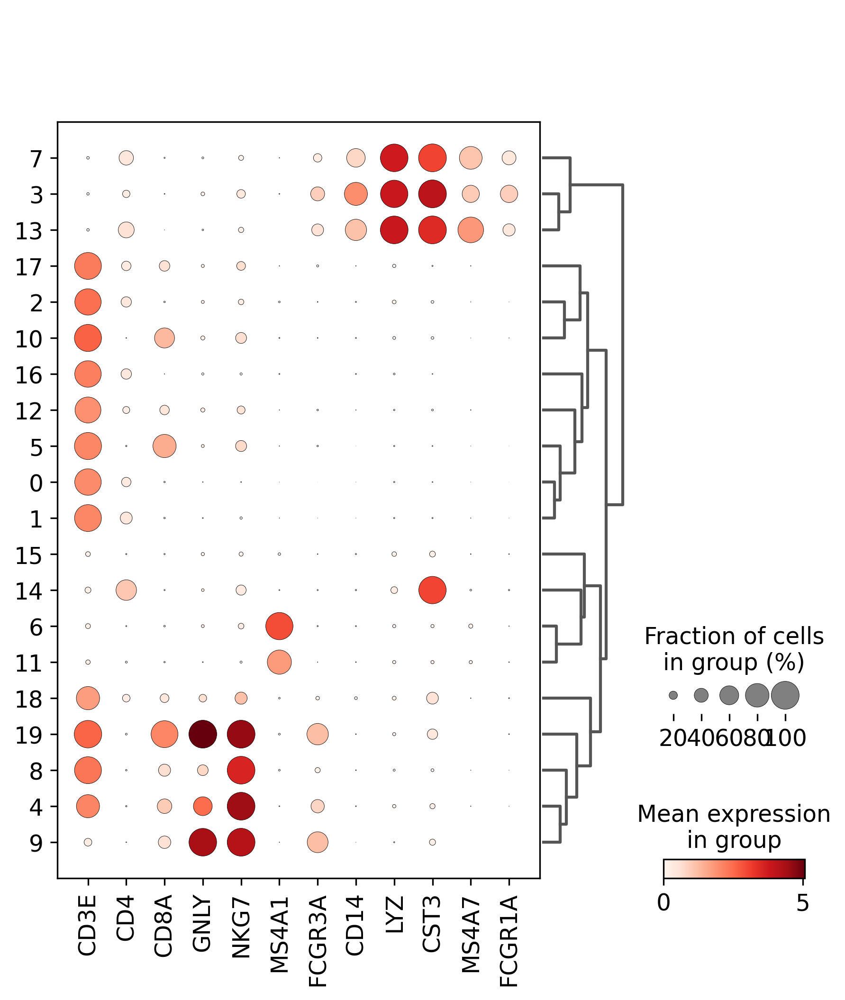

In [70]:
sc.tl.dendrogram(adata, groupby = "louvain_0.6")
sc.pl.dendrogram(adata, groupby = "louvain_0.6")

genes  = ["CD3E", "CD4", "CD8A", "GNLY","NKG7", "MS4A1","FCGR3A","CD14","LYZ","CST3","MS4A7","FCGR1A"]

sc.pl.dotplot(adata, genes, groupby='louvain_0.6', dendrogram=True, save="__louvan.png")

In [71]:
!pip install scanorama

In [72]:
!pip install scikit-learn

In [73]:
# T test

In [74]:
sc.tl.rank_genes_groups(adata, 'louvain_0.6', method='t-test', key_added = "t-test")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key = "t-test", save="_ranbk_louvan_0.6.png")

Output hidden; open in https://colab.research.google.com to view.

T-test overestimated_variance

In [75]:
sc.tl.rank_genes_groups(adata, 'louvain_0.6', method='t-test_overestim_var', key_added = "t-test_ov")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key = "t-test_ov", save="_louvain_0.6_ov_test.png")

Output hidden; open in https://colab.research.google.com to view.

Wilcoxon rank-sum

In [76]:
sc.tl.rank_genes_groups(adata, 'louvain_0.6', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key="wilcoxon", save="_wilxon_rank.png")

Output hidden; open in https://colab.research.google.com to view.

 Logistic regression test

In [77]:
sc.tl.rank_genes_groups(adata, 'louvain_0.6', method='logreg',key_added = "logreg")
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key = "logreg", save="_logregress_rank.png")

Output hidden; open in https://colab.research.google.com to view.

Compare genes<br>
Take all significant DE genes for cluster0 with each test and compare the overlap.

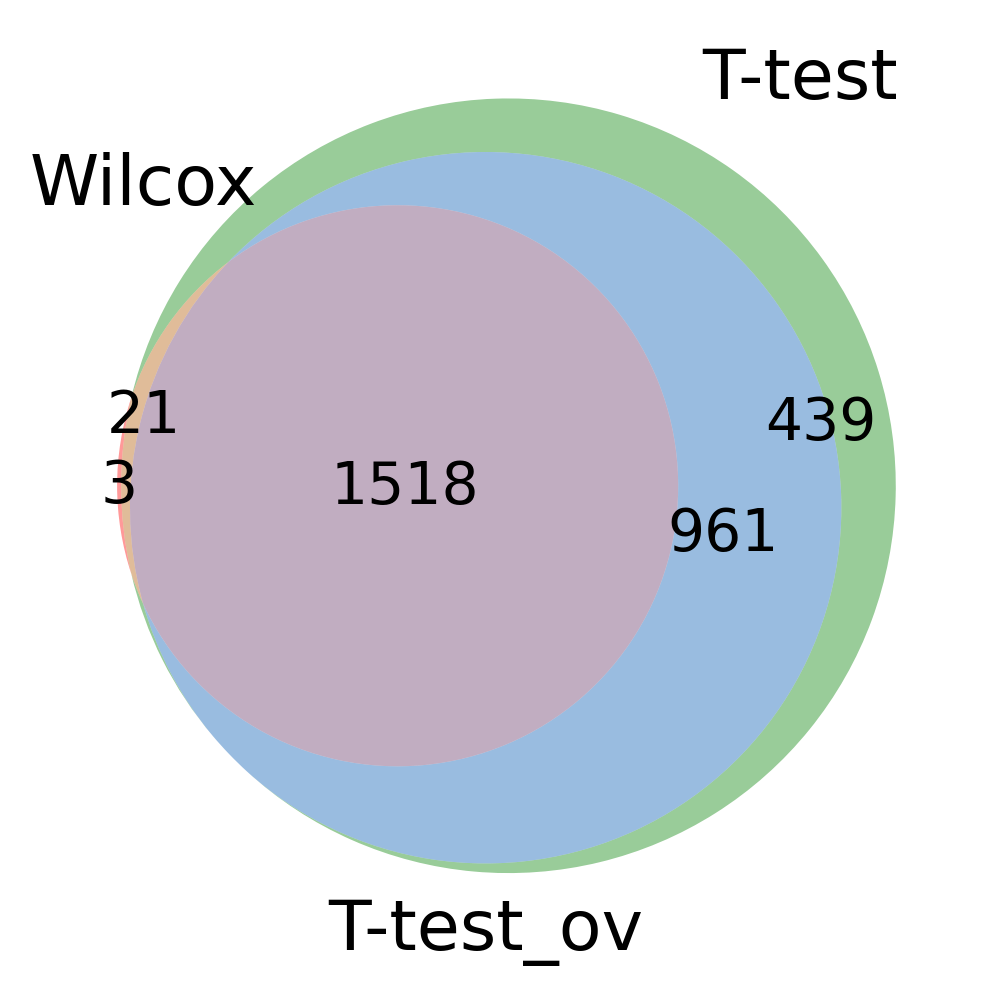

In [78]:
#compare cluster1 genes, only stores top 100 by default
import matplotlib.pyplot as plt

wc = sc.get.rank_genes_groups_df(adata, group='0', key='wilcoxon', pval_cutoff=0.01, log2fc_min=0)['names']
tt = sc.get.rank_genes_groups_df(adata, group='0', key='t-test', pval_cutoff=0.01, log2fc_min=0)['names']
tt_ov = sc.get.rank_genes_groups_df(adata, group='0', key='t-test_ov', pval_cutoff=0.01, log2fc_min=0)['names']

from matplotlib_venn import venn3

venn3([set(wc),set(tt),set(tt_ov)], ('Wilcox','T-test','T-test_ov') )
plt.savefig("./figures/compres_ttest.png")
plt.show()

Visualization

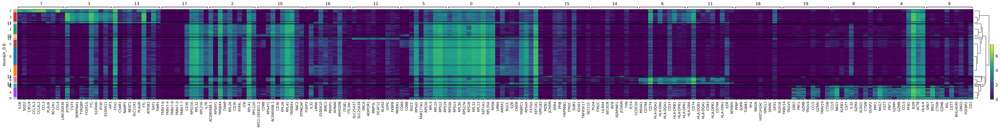

In [79]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=10, key="wilcoxon", groupby="louvain_0.6", show_gene_labels=True, save="_top_10_gene.png")

In [80]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=10, key="wilcoxon", groupby="louvain_0.6", save="_top10.png")

Output hidden; open in https://colab.research.google.com to view.

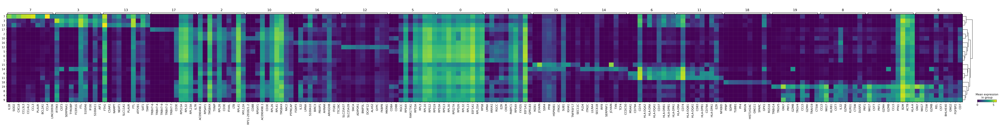

In [81]:
sc.pl.rank_genes_groups_matrixplot(adata, n_genes=10, key="wilcoxon", groupby="louvain_0.6", save="_ttopDE10.png")

 Compare specific clusters

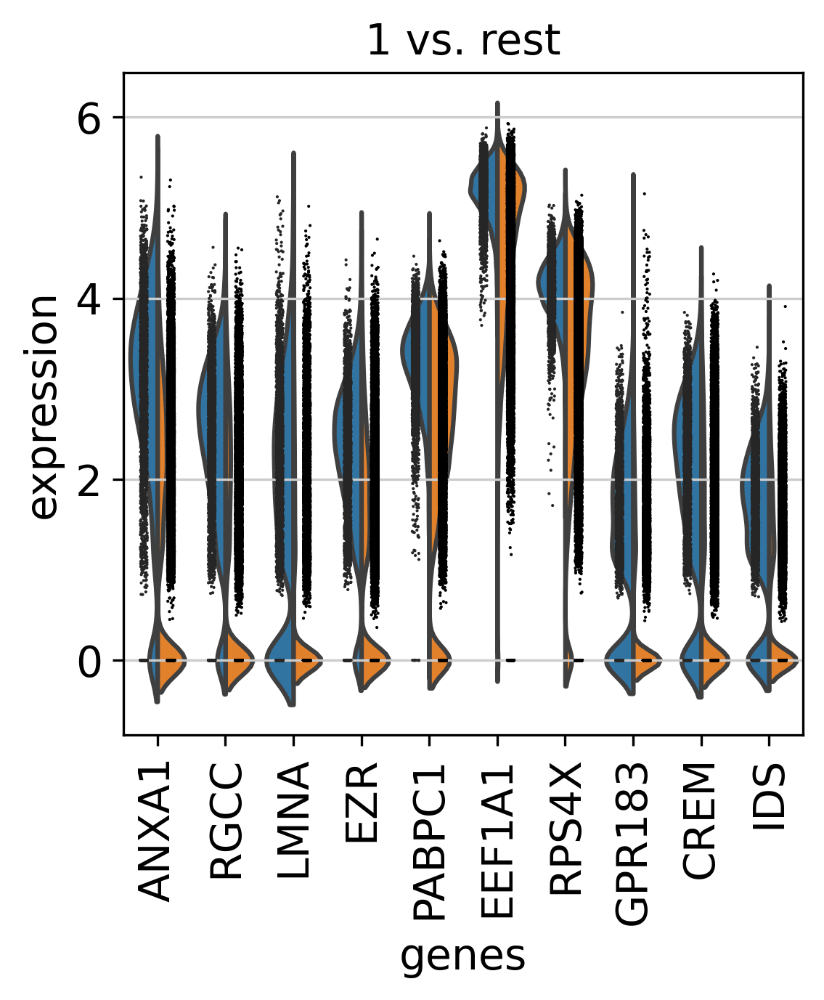

In [82]:
sc.pl.rank_genes_groups_violin(adata, groups='1', n_genes=10, save="_cluster1_rest.png")

Differential expression across conditions

In [83]:
cl1 = adata[adata.obs['louvain_0.6'] == '2',:]
cl1.obs['type'].value_counts()

Ctrl      2761
dengue      73
Name: type, dtype: int64

ranking genes
Trying to set attribute `.uns` of view, copying.
    finished (0:00:04)


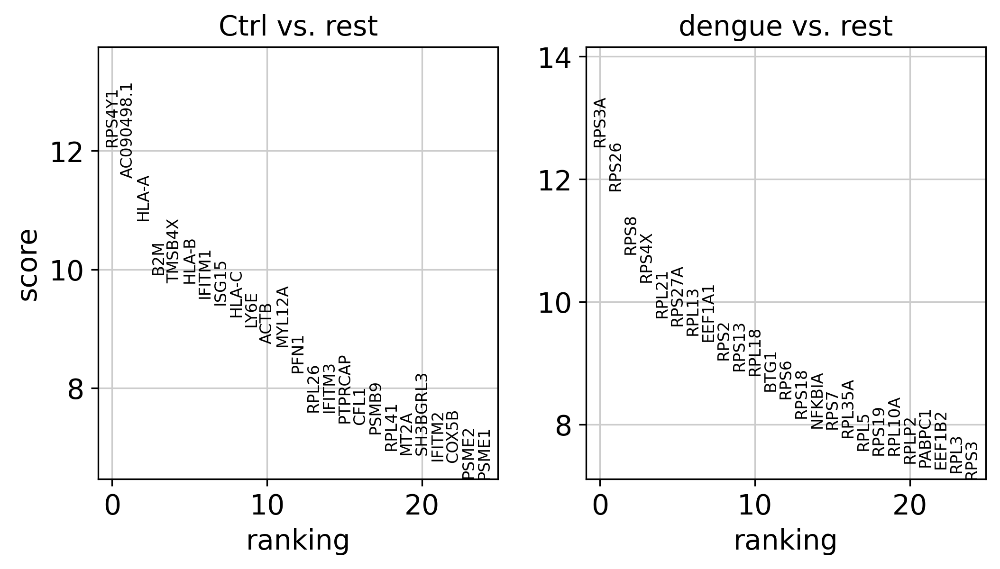

In [84]:
sc.tl.rank_genes_groups(cl1, 'type', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(cl1, n_genes=25, sharey=False, key="wilcoxon", save="_DE_DENV.png")

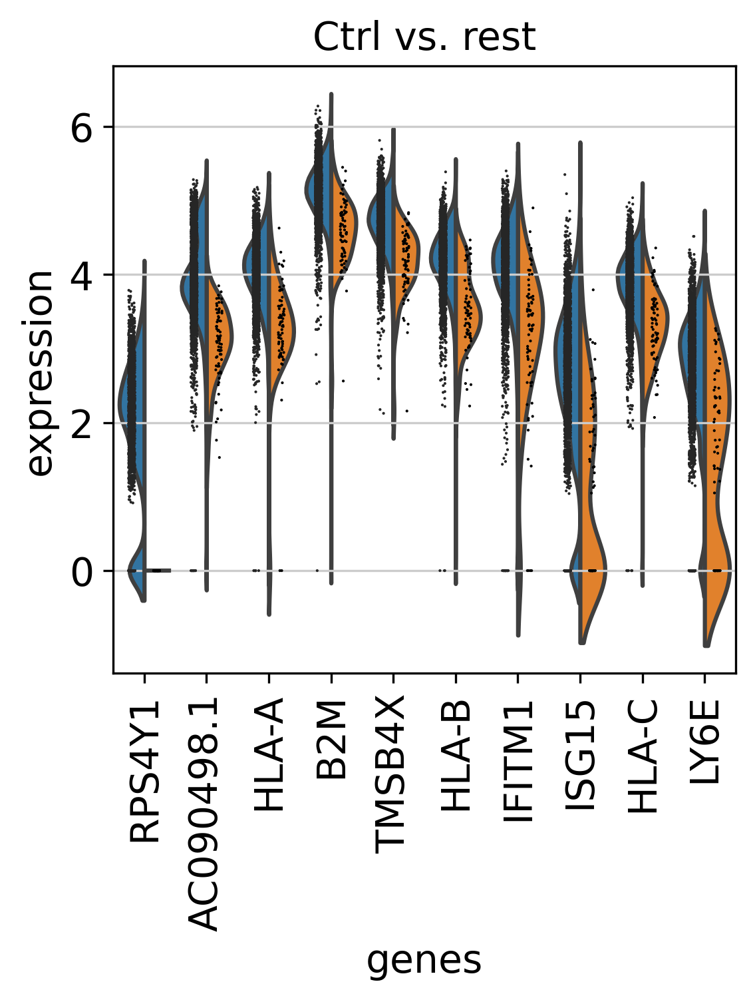

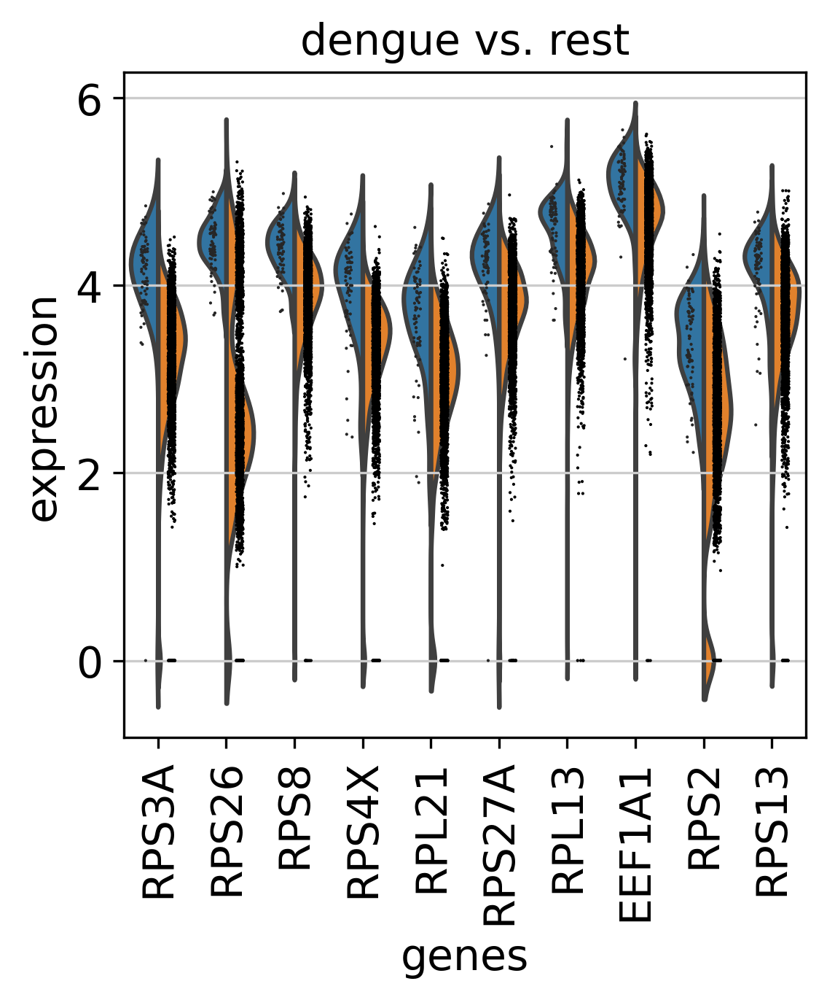

In [85]:
sc.pl.rank_genes_groups_violin(cl1, n_genes=10, key="wilcoxon", save="_violoing_DE_DENV.png")

In [86]:
import seaborn as sns

genes1 = sc.get.rank_genes_groups_df(cl1, group='dengue', key='wilcoxon')['names'][:5]
genes2 = sc.get.rank_genes_groups_df(cl1, group='Ctrl', key='wilcoxon')['names'][:5]
genes = genes1.tolist() +  genes2.tolist() 
df = sc.get.obs_df(adata, genes + ['louvain_0.6','type'], use_raw=True)
df2 = df.melt(id_vars=["louvain_0.6",'type'], value_vars=genes)

In [87]:
sns_plot=sns.factorplot(x = "louvain_0.6", y = "value", hue = "type", kind = 'violin', 
               col = "variable", data = df2, col_wrap=4, inner=None)
sns_plot.savefig('./figures/_sns_ogenes_across_all_clusters.png')

Output hidden; open in https://colab.research.google.com to view.

In [88]:
!pip install gseapy

Gene Set Analysis

In [89]:
import gseapy

In [90]:
gene_set_names = gseapy.get_library_name(database='Human')
for i in gene_set_names:
    print(i, end="\n")

ARCHS4_Cell-lines
ARCHS4_IDG_Coexp
ARCHS4_Kinases_Coexp
ARCHS4_TFs_Coexp
ARCHS4_Tissues
Achilles_fitness_decrease
Achilles_fitness_increase
Aging_Perturbations_from_GEO_down
Aging_Perturbations_from_GEO_up
Allen_Brain_Atlas_10x_scRNA_2021
Allen_Brain_Atlas_down
Allen_Brain_Atlas_up
BioCarta_2013
BioCarta_2015
BioCarta_2016
BioPlanet_2019
BioPlex_2017
CCLE_Proteomics_2020
CORUM
COVID-19_Related_Gene_Sets
Cancer_Cell_Line_Encyclopedia
ChEA_2013
ChEA_2015
ChEA_2016
Chromosome_Location
Chromosome_Location_hg19
ClinVar_2019
DSigDB
Data_Acquisition_Method_Most_Popular_Genes
DepMap_WG_CRISPR_Screens_Broad_CellLines_2019
DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019
Descartes_Cell_Types_and_Tissue_2021
DisGeNET
Disease_Perturbations_from_GEO_down
Disease_Perturbations_from_GEO_up
Disease_Signatures_from_GEO_down_2014
Disease_Signatures_from_GEO_up_2014
DrugMatrix
Drug_Perturbations_from_GEO_2014
Drug_Perturbations_from_GEO_down
Drug_Perturbations_from_GEO_up
ENCODE_Histone_Modifications_2013


In [91]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(cl1, group='dengue', key='wilcoxon')['names'].squeeze().str.strip().tolist()
print(len(glist))

21777


In [92]:
print(glist[:10])

['RPS3A', 'RPS26', 'RPS8', 'RPS4X', 'RPL21', 'RPS27A', 'RPL13', 'EEF1A1', 'RPS2', 'RPS13']


In [93]:
enr_res1 = gseapy.enrichr(gene_list=glist[:8000],
                     organism="Human",
                     gene_sets='GO_Biological_Process_2018',
                     description='pathway',
                     cutoff = 0.5)
enr_res2 = gseapy.enrichr(gene_list=glist[8000:16000],
                     organism="Human",
                     gene_sets='GO_Biological_Process_2018',
                     description='pathway',
                     cutoff = 0.5)
enr_res3 = gseapy.enrichr(gene_list=glist[16000:],
                     organism="Human",
                     gene_sets='GO_Biological_Process_2018',
                     description='pathway',
                     cutoff = 0.5)

In [94]:
enr_res = [enr_res1.results, enr_res2.results, enr_res3.results]

In [95]:
cl1.raw.X.shape

(2834, 21777)

In [96]:
adata

AnnData object with n_obs × n_vars = 25279 × 1263
    obs: 'type', 'sample', 'batch', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'n_genes', 'leiden', 'leiden_1.0', 'leiden_0.6', 'leiden_0.4', 'leiden_1.4', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4'
    var: 'gene_ids', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'sample_colors', 'umap', 'leiden_0.4_colors', 'leiden_0.6_colors', 'leiden_1.0_colors', 'leiden_1.4_colors', 'dendrogram_leiden_0.6', 'louvain', 'louvain_0.4_colors', 'louvain_0.6_colors', 'louvain_1.0_colors', 'louvain_1.4_colors', 'dendrogram_louvain_0.6', 't-test', 't-test_ov', 'wilcoxon', 'logreg'
    obsm:

In [97]:
# filter for genes that are expressed in more than 5 cells
tmp = cl1.raw.to_adata() 
sc.pp.calculate_qc_metrics(tmp, percent_top=None, log1p=False, inplace=True)
tmp = tmp[:,tmp.var['highly_variable']]

In [98]:
sc.tl.rank_genes_groups(tmp, 'type', method='wilcoxon', key_added = "wilcoxon")


sc.get.rank_genes_groups_df(tmp, group='dengue', key='wilcoxon')

ranking genes
Trying to set attribute `.uns` of view, copying.
    finished (0:00:00)


,names,scores,logfoldchanges,pvals,pvals_adj
0,NFKBIA,7.941816,1.712219,1.992421e-15,1.258214e-12
1,CCR7,5.648576,1.886061,1.617819e-08,3.405510e-06
2,TNFAIP3,4.132020,1.259489,3.595898e-05,3.784682e-03
3,RGCC,3.518006,1.336464,4.348024e-04,3.432221e-02
4,GPR183,3.348018,1.373021,8.139161e-04,5.514583e-02
...,...,...,...,...,...
1258,TXNIP,-5.454967,-0.885241,4.898187e-08,8.837729e-06
1259,IRF7,-6.071806,-1.764759,1.264792e-09,3.194864e-07
1260,IER2,-6.255706,-1.394584,3.957207e-10,1.249488e-07
1261,MT2A,-6.882400,-1.926318,5.885243e-12,2.477687e-09


In [99]:
glist = sc.get.rank_genes_groups_df(tmp, group='dengue', key='wilcoxon')['names'].squeeze().str.strip().tolist()
print(len(glist))

1263


In [100]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Biological_Process_2018',
                     description='pathway',
                     cutoff = 0.5)

In [101]:
enr_res.results.head()

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2018,humoral immune response mediated by circulatin...,94/125,1.983500e-86,6.525715e-83,0,0,48.521317,9575.073173,IGHM;IGHV4-31;IGHV3-20;IGHV3-64;IGHV3-21;IGHV1...
1,GO_Biological_Process_2018,"complement activation, classical pathway (GO:0...",93/123,6.729586e-86,1.107017e-82,0,0,49.565556,9720.588799,IGHM;IGHV4-31;IGHV3-20;IGHV3-64;IGHV3-21;IGHV1...
2,GO_Biological_Process_2018,regulation of immune response (GO:0050776),100/251,2.982790e-54,3.271126e-51,0,0,10.583499,1304.381700,IGHV3-23;TRAC;SLA2;ICAM1;IGLV2-8;IGKV1-16;IGKV...
3,GO_Biological_Process_2018,regulation of acute inflammatory response (GO:...,71/121,1.516081e-53,1.246977e-50,0,0,22.261359,2707.446099,IGHV3-23;IGHV1-2;IGHV4-34;IGHV1-46;IGHV4-39;CL...
4,GO_Biological_Process_2018,regulation of immune effector process (GO:0002...,69/114,2.269048e-53,1.493034e-50,0,0,24.004243,2909.737966,IGHV3-23;IGHV1-2;IGHV4-34;IGHV1-46;IGHV4-39;CL...


In [102]:
enr_res.res2d.sort_index().head()

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2018,humoral immune response mediated by circulatin...,94/125,1.983500e-86,6.525715e-83,0,0,48.521317,9575.073173,IGHM;IGHV4-31;IGHV3-20;IGHV3-64;IGHV3-21;IGHV1...
1,GO_Biological_Process_2018,"complement activation, classical pathway (GO:0...",93/123,6.729586e-86,1.107017e-82,0,0,49.565556,9720.588799,IGHM;IGHV4-31;IGHV3-20;IGHV3-64;IGHV3-21;IGHV1...
2,GO_Biological_Process_2018,regulation of immune response (GO:0050776),100/251,2.982790e-54,3.271126e-51,0,0,10.583499,1304.381700,IGHV3-23;TRAC;SLA2;ICAM1;IGLV2-8;IGKV1-16;IGKV...
3,GO_Biological_Process_2018,regulation of acute inflammatory response (GO:...,71/121,1.516081e-53,1.246977e-50,0,0,22.261359,2707.446099,IGHV3-23;IGHV1-2;IGHV4-34;IGHV1-46;IGHV4-39;CL...
4,GO_Biological_Process_2018,regulation of immune effector process (GO:0002...,69/114,2.269048e-53,1.493034e-50,0,0,24.004243,2909.737966,IGHV3-23;IGHV1-2;IGHV4-34;IGHV1-46;IGHV4-39;CL...


In [103]:
from gseapy.plot import barplot, dotplot
from gseapy.plot import gseaplot, heatmap

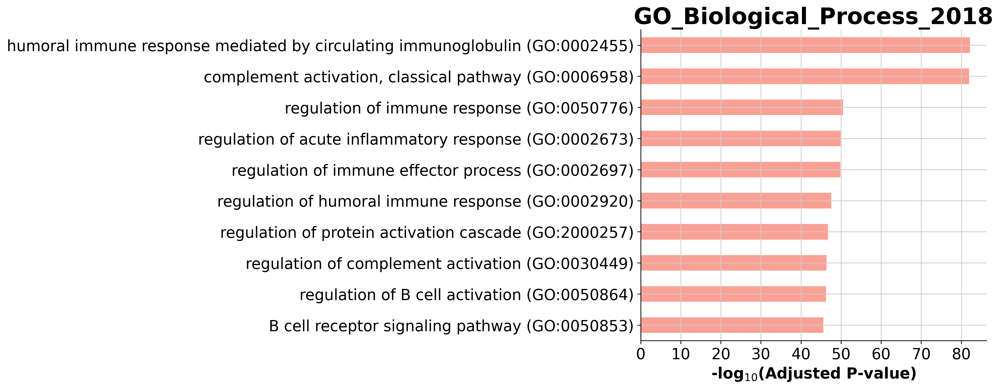

In [104]:
a=barplot(enr_res.res2d,title='GO_Biological_Process_2018')


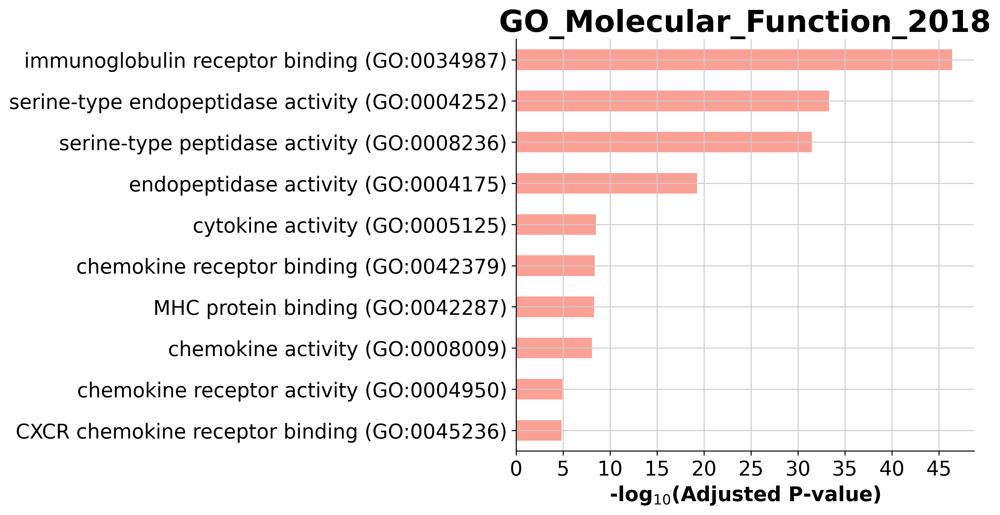

In [105]:
enr_resGO_MF = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Molecular_Function_2018',
                     description='pathway',
                     cutoff = 0.5)

barplot(enr_resGO_MF.res2d,title='GO_Molecular_Function_2018')


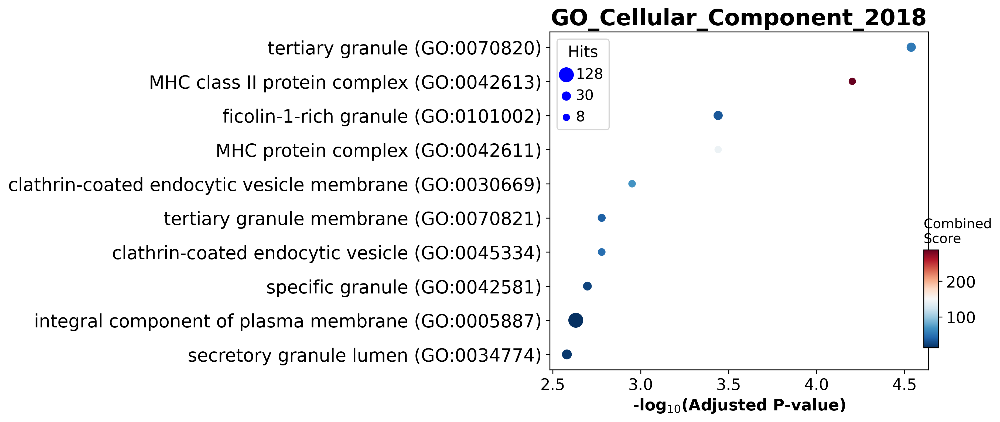

In [106]:
enr_resGO_CC = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Cellular_Component_2018',
                     description='pathway',
                     cutoff = 0.5)

dotplot(enr_resGO_CC.res2d,title='GO_Cellular_Component_2018')

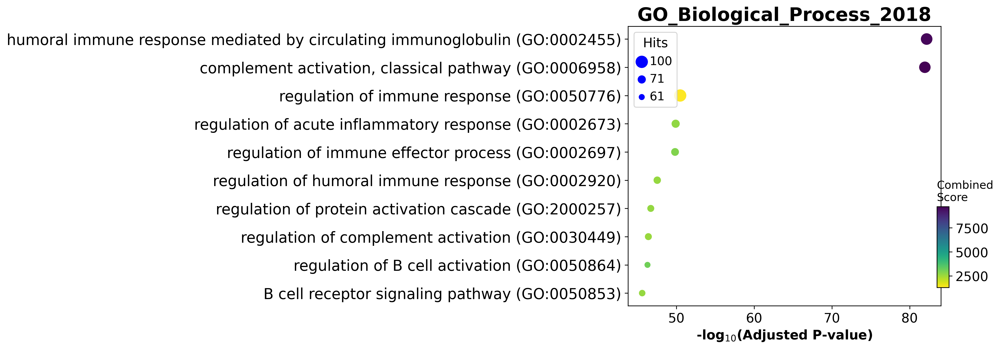

In [107]:
p= dotplot(enr_res.res2d, title='GO_Biological_Process_2018',cmap='viridis_r')
p.figure.savefig("./figures/asda.png")

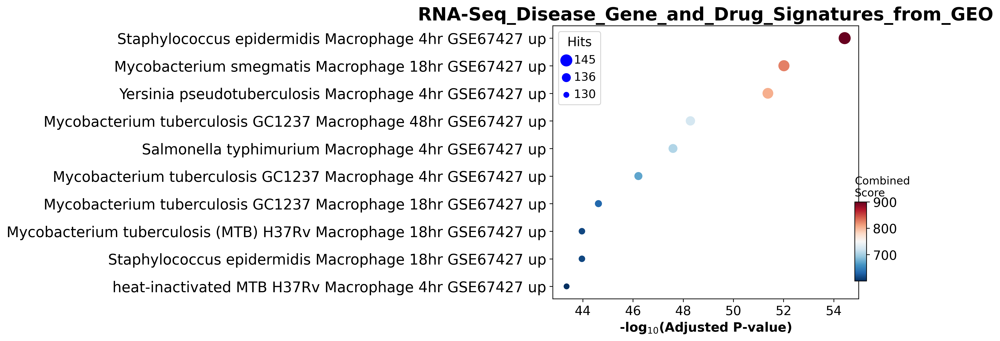

In [108]:
enr_resDrug = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='RNA-Seq_Disease_Gene_and_Drug_Signatures_from_GEO',
                     description='pathway',
                     cutoff = 0.5)

dotplot(enr_resDrug.res2d,title='RNA-Seq_Disease_Gene_and_Drug_Signatures_from_GEO')

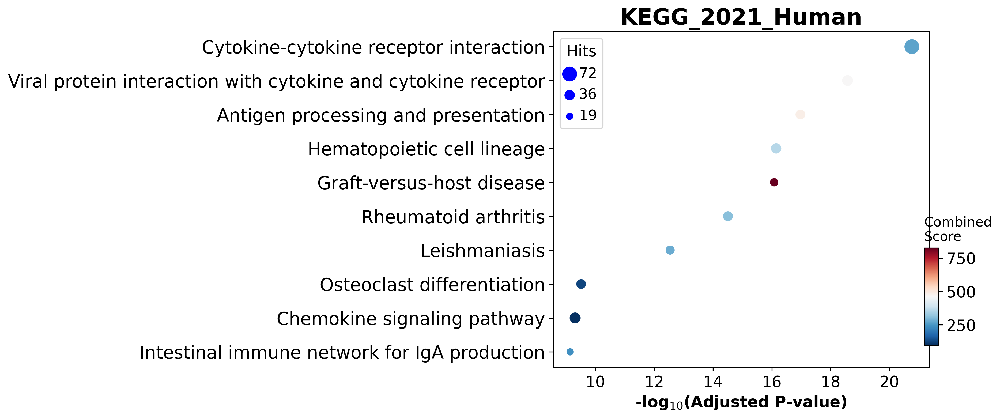

In [109]:
enr_resKEGG = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='KEGG_2021_Human',
                     description='pathway',
                     cutoff = 0.5)

dotplot(enr_resKEGG.res2d,title='KEGG_2021_Human')

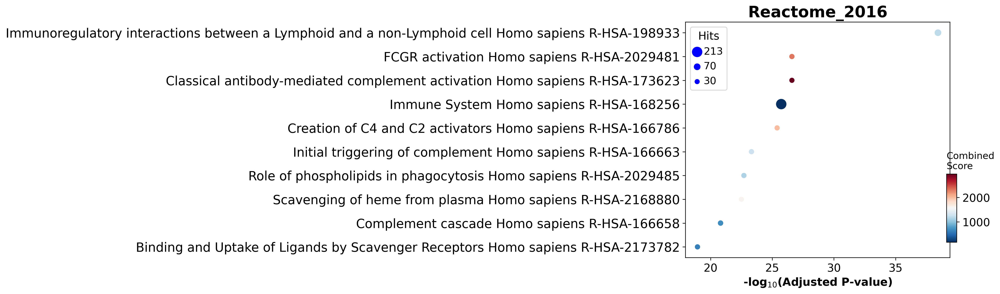

In [110]:
enr_resRECT = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='Reactome_2016',
                     description='pathway',
                     cutoff = 0.5)
dotplot(enr_resRECT.res2d,title='Reactome_2016')

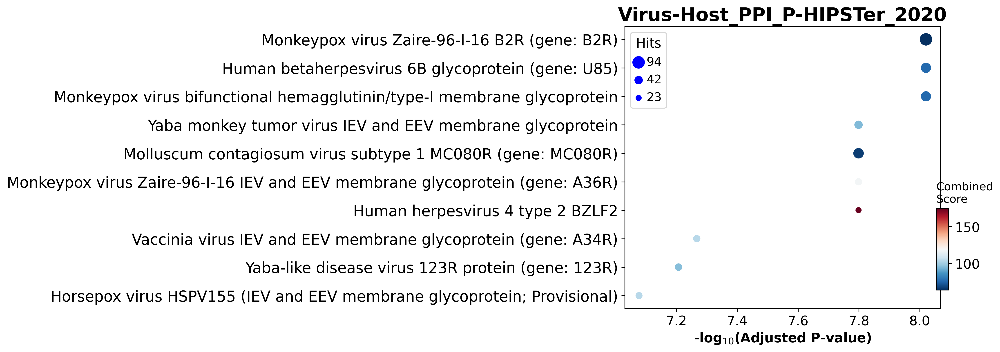

In [111]:
enr_resVH = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='Virus-Host_PPI_P-HIPSTer_2020',
                     description='pathway',
                     cutoff = 0.5)
dotplot(enr_resVH.res2d,title='Virus-Host_PPI_P-HIPSTer_2020')

In [112]:
gene_rank = sc.tl.rank_genes_groups(cl1, 'type', method='wilcoxon', key_added = "wilcoxon",n_genes=cl1.shape[0])
gene_rank1 = sc.get.rank_genes_groups_df(cl1, group='dengue', key='wilcoxon')[['names','logfoldchanges']]
gene_rank2 = sc.get.rank_genes_groups_df(cl1, group='Ctrl', key='wilcoxon')[['names','logfoldchanges']]

ranking genes
    finished (0:00:04)


In [113]:
gene_rank2['logfoldchanges'] = -gene_rank2['logfoldchanges']
gene_rank2
gene_rank = gene_rank1.append( gene_rank2 )

In [114]:
gene_set_names = gseapy.get_library_name(database='Human')
print(gene_set_names)

['ARCHS4_Cell-lines', 'ARCHS4_IDG_Coexp', 'ARCHS4_Kinases_Coexp', 'ARCHS4_TFs_Coexp', 'ARCHS4_Tissues', 'Achilles_fitness_decrease', 'Achilles_fitness_increase', 'Aging_Perturbations_from_GEO_down', 'Aging_Perturbations_from_GEO_up', 'Allen_Brain_Atlas_10x_scRNA_2021', 'Allen_Brain_Atlas_down', 'Allen_Brain_Atlas_up', 'BioCarta_2013', 'BioCarta_2015', 'BioCarta_2016', 'BioPlanet_2019', 'BioPlex_2017', 'CCLE_Proteomics_2020', 'CORUM', 'COVID-19_Related_Gene_Sets', 'Cancer_Cell_Line_Encyclopedia', 'ChEA_2013', 'ChEA_2015', 'ChEA_2016', 'Chromosome_Location', 'Chromosome_Location_hg19', 'ClinVar_2019', 'DSigDB', 'Data_Acquisition_Method_Most_Popular_Genes', 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019', 'DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019', 'Descartes_Cell_Types_and_Tissue_2021', 'DisGeNET', 'Disease_Perturbations_from_GEO_down', 'Disease_Perturbations_from_GEO_up', 'Disease_Signatures_from_GEO_down_2014', 'Disease_Signatures_from_GEO_up_2014', 'DrugMatrix', 'Drug_Perturbati

In [115]:
res = gseapy.prerank(rnk=gene_rank, gene_sets='WikiPathways_2019_Human')


In [116]:
terms = res.res2d.index
terms[:20]

Index(['Aryl Hydrocarbon Receptor WP2586',
       'Photodynamic therapy-induced NF-kB survival signaling WP3617',
       'Alzheimers Disease WP2059', 'Neural Crest Differentiation WP2064',
       'Bladder Cancer WP2828',
       'Sudden Infant Death Syndrome (SIDS) Susceptibility Pathways WP706',
       'miRNA regulation of prostate cancer signaling pathways WP3981',
       'Aryl Hydrocarbon Receptor Pathway WP2873',
       'Parkin-Ubiquitin Proteasomal System pathway WP2359',
       'Oxidative Damage WP3941',
       'Wnt Signaling Pathway and Pluripotency WP399',
       'Non-genomic actions of 1,25 dihydroxyvitamin D3 WP4341',
       'White fat cell differentiation WP4149',
       'Interferon type I signaling pathways WP585',
       'IL-7 Signaling Pathway WP205',
       'Regulation of Microtubule Cytoskeleton WP2038',
       'Fas Ligand (FasL) pathway and Stress induction of Heat Shock Proteins (HSP) regulation WP314',
       'Endochondral Ossification WP474', 'Translation Factors WP1

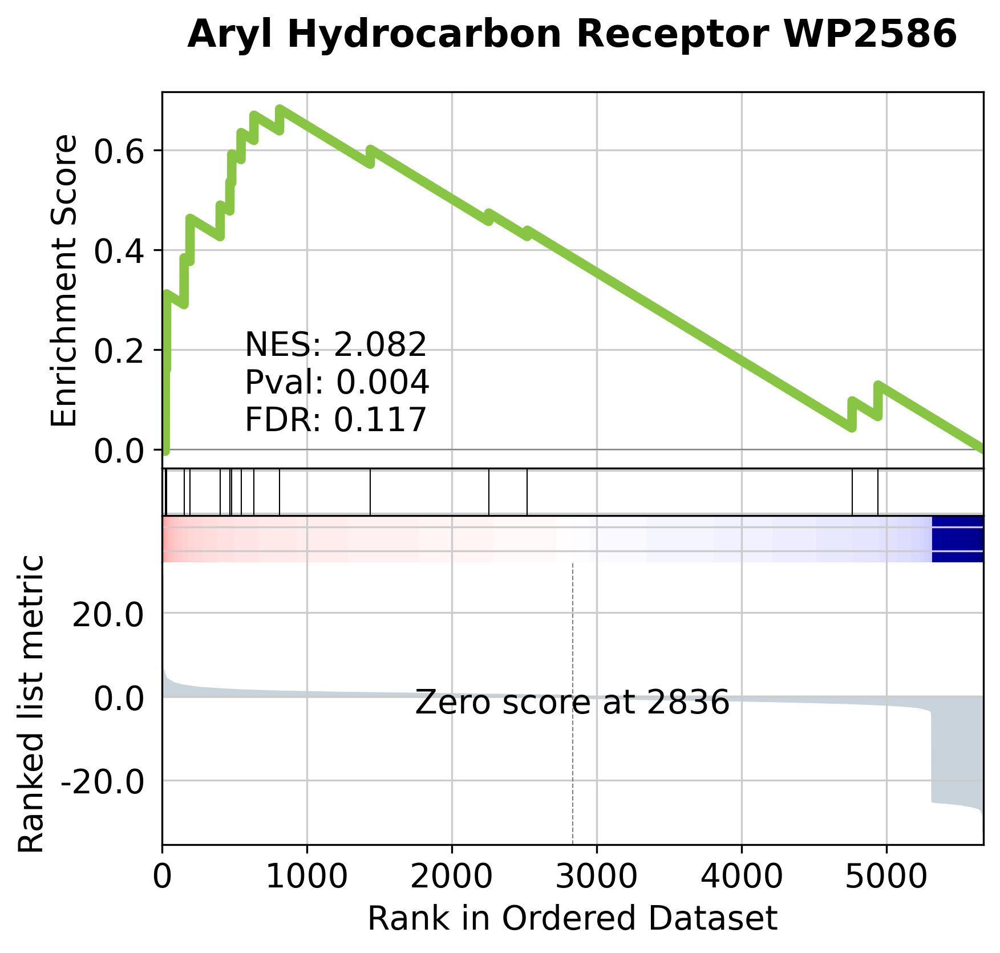

In [117]:
gseapy.gseaplot(rank_metric=res.ranking, term=terms[0],show=True,**res.results[terms[0]])

In [118]:
terms = enr_res.res2d.index
print(terms)

RangeIndex(start=0, stop=3290, step=1)


In [119]:
adata.write_h5ad("scanpy_DGE_dengue.h5ad")

In [120]:
adata.write(results_file, compression='gzip')

In [121]:
adata.raw.to_adata().write('/content/drive/MyDrive/SC/SCANPY/write/denv_withoutX.h5ad')

In [157]:
cp -r ./figures/ /content/drive/MyDrive/SC/SCANPY/figures/colab/

In [156]:
cp -r ./sample_data/ /content/drive/MyDrive/SC/SCANPY/figures/colab/

THE END **MAIN**  Testing ~~~~ Playground

---



In [123]:
sc.tl.draw_graph(adata)

drawing single-cell graph using layout 'fa'
    finished (0:05:13)


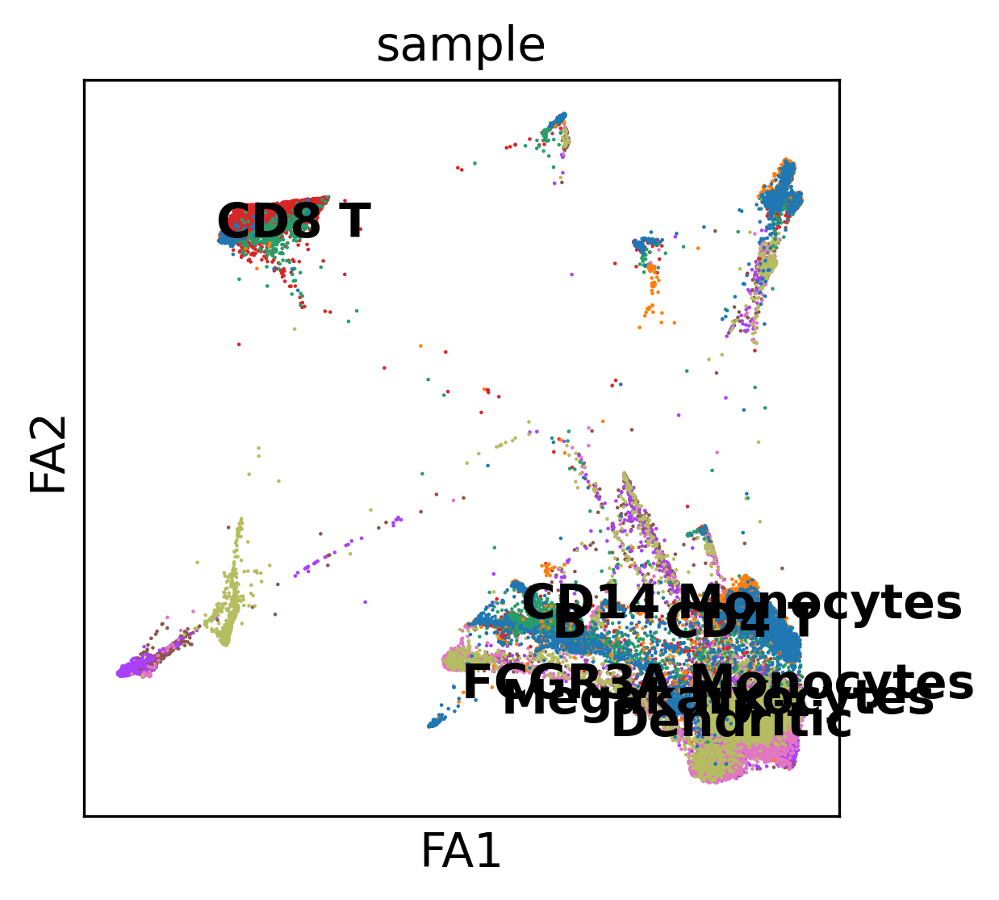

In [124]:
sc.pl.draw_graph(adata, color='sample', legend_loc='on data')

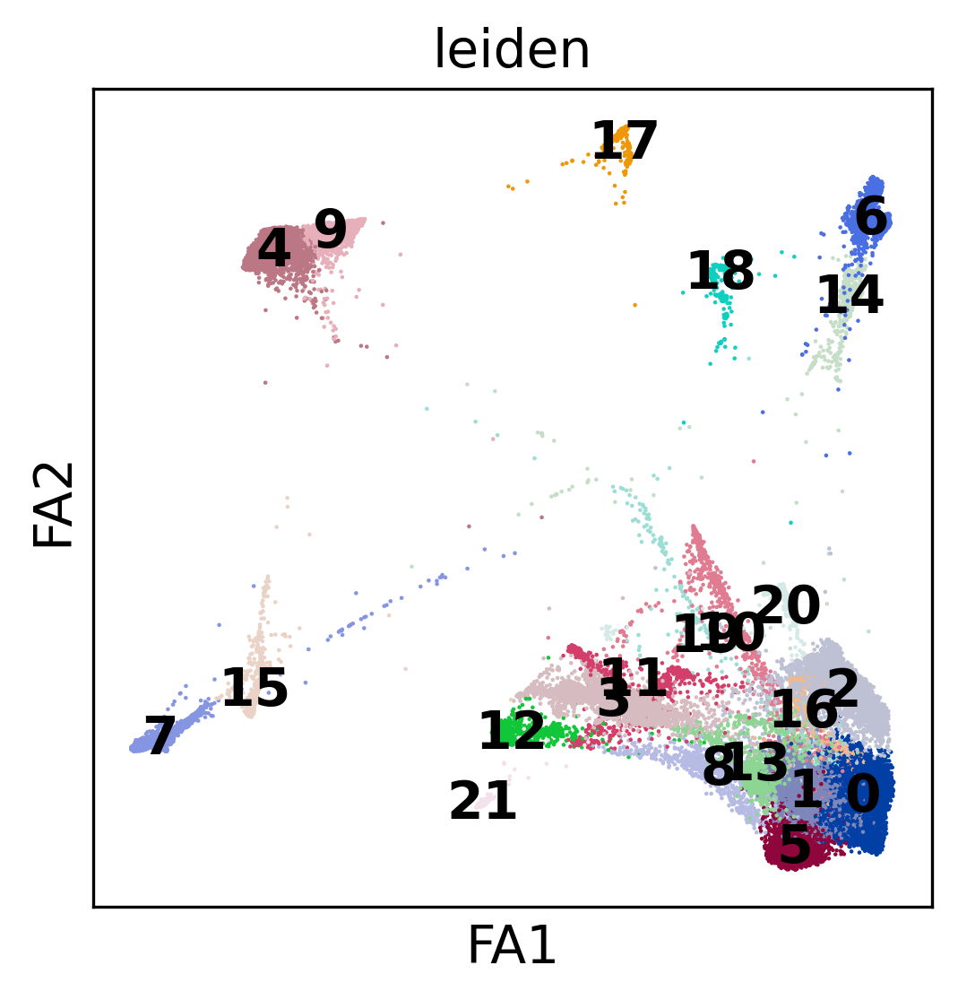

In [125]:
sc.pl.draw_graph(adata, color='leiden', legend_loc='on data', save="_.png")

denoise for better images

In [126]:
sc.tl.diffmap(adata)
sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_diffmap')

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.99918574 0.9978023  0.9977272  0.99713475 0.9925094
     0.99216604 0.99137527 0.98821294 0.9871597  0.98498774 0.98352575
     0.98334736 0.98094684 0.9735872 ]
    finished (0:00:02)
computing neighbors
    finished (0:00:01)


In [127]:
sc.tl.draw_graph(adata)

drawing single-cell graph using layout 'fa'
    finished (0:04:55)


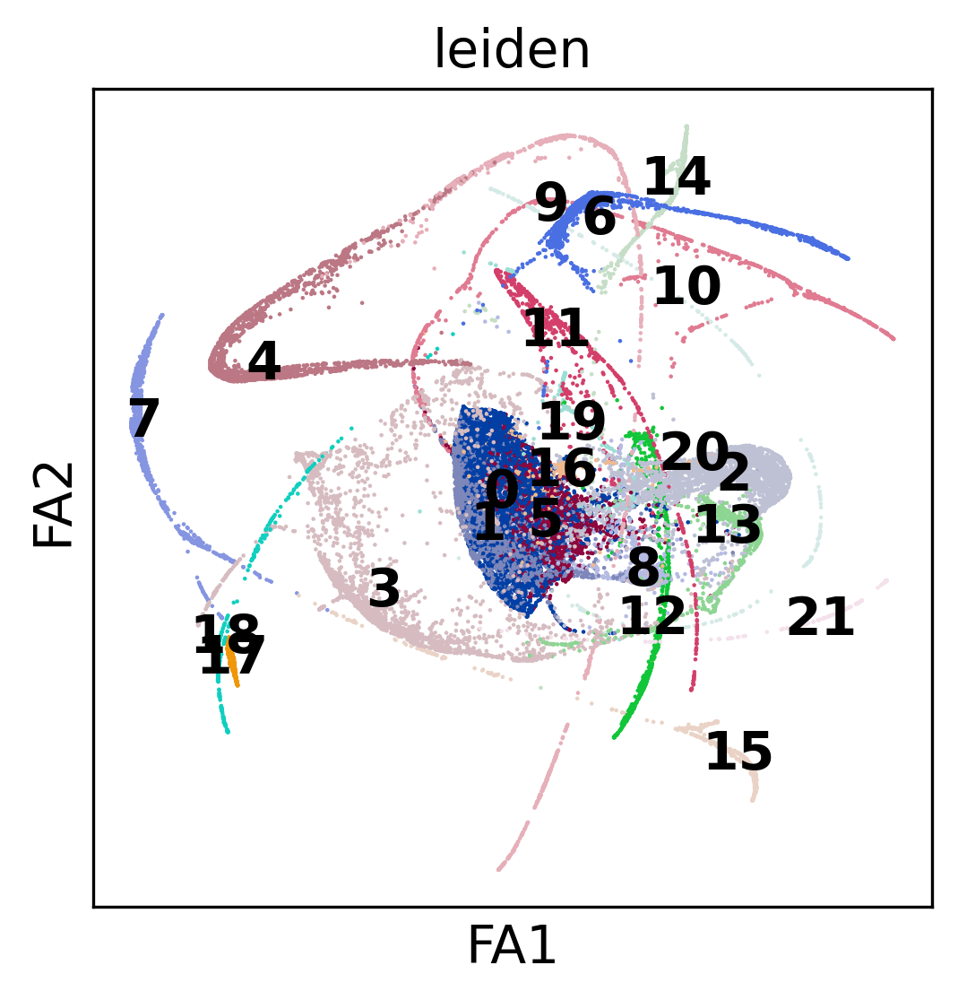

In [128]:
sc.pl.draw_graph(adata, color='leiden', legend_loc='on data')

Clustering and PAGA

In [129]:
sc.tl.louvain(adata, resolution=1.0)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:02)


In [130]:
sc.tl.paga(adata, groups='louvain')

running PAGA
    finished (0:00:02)


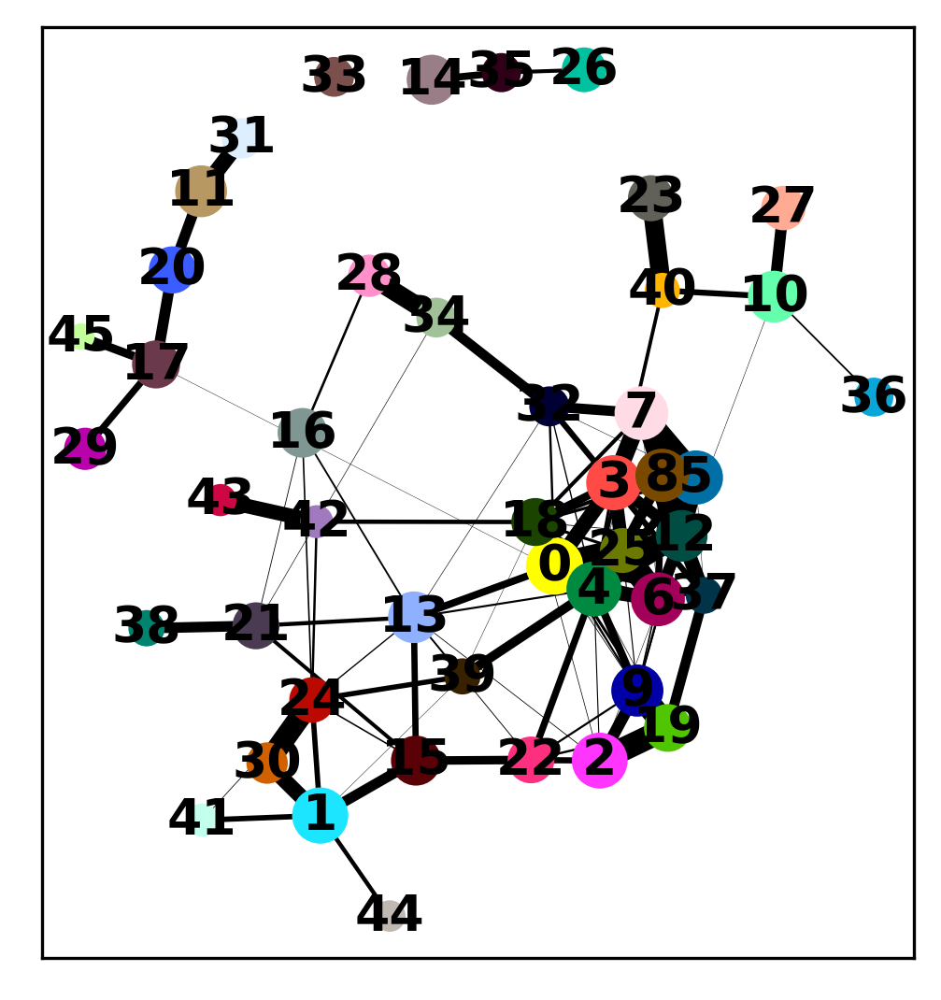

In [131]:
sc.pl.paga(adata)

Actually annotate the clusters — note that Cma1 is a Mast cell marker and only appears in a small fraction of the cells in the progenitor/stem cell cluster 8, see the single-cell resolved plot below.

In [132]:
adata.obs['louvain'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24',
       '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36',
       '37', '38', '39', '40', '41', '42', '43', '44', '45'],
      dtype='object')

In [133]:
adata.obs['louvain_anno'] = adata.obs['louvain']

In [134]:
adata.obs['louvain_anno'].cat.categories = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24','25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36',
       '37', '38', '39', '40', '41', '42', '43', '44', '45' ]

Let’s use the annotated clusters for PAGA.

In [135]:
sc.tl.paga(adata, groups='louvain_anno')

running PAGA
    finished (0:00:02)


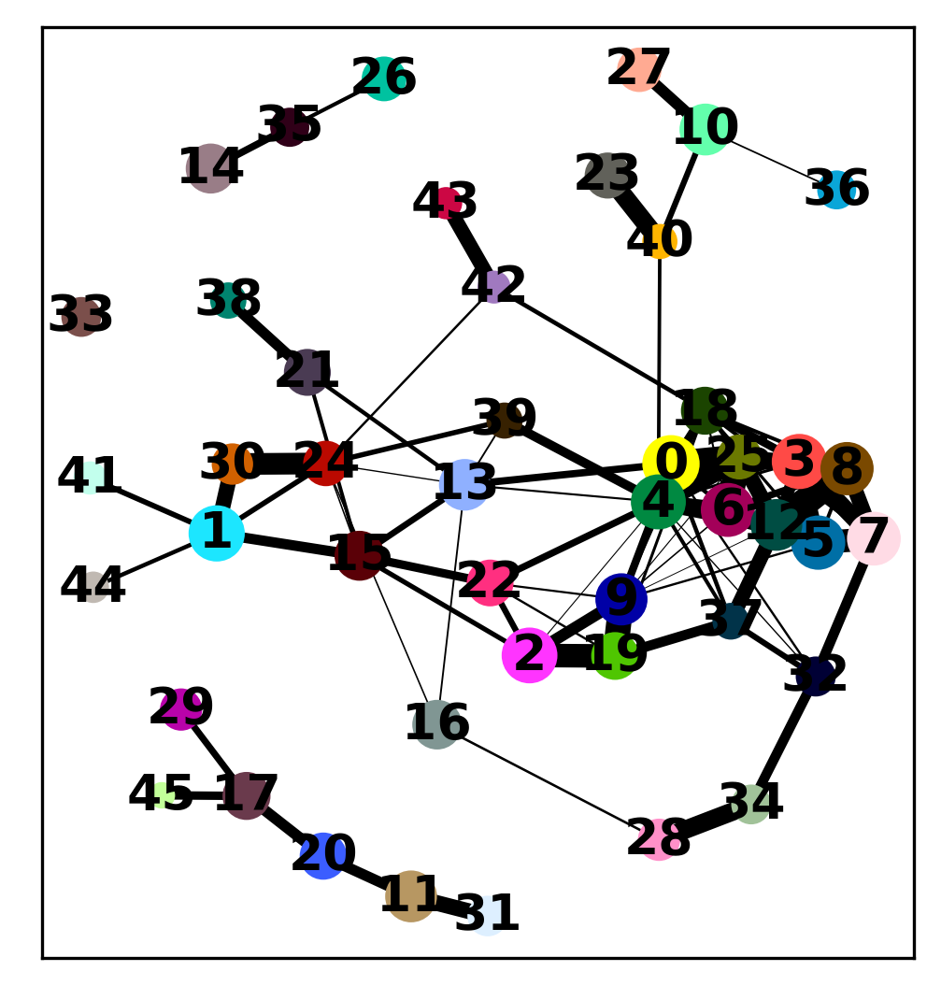

In [136]:
sc.pl.paga(adata, threshold=0.03, show=True, save="__trajectory_.png")

Recomputing the embedding using PAGA-initialization

In [137]:
sc.tl.draw_graph(adata, init_pos='paga')

drawing single-cell graph using layout 'fa'
    finished (0:04:35)


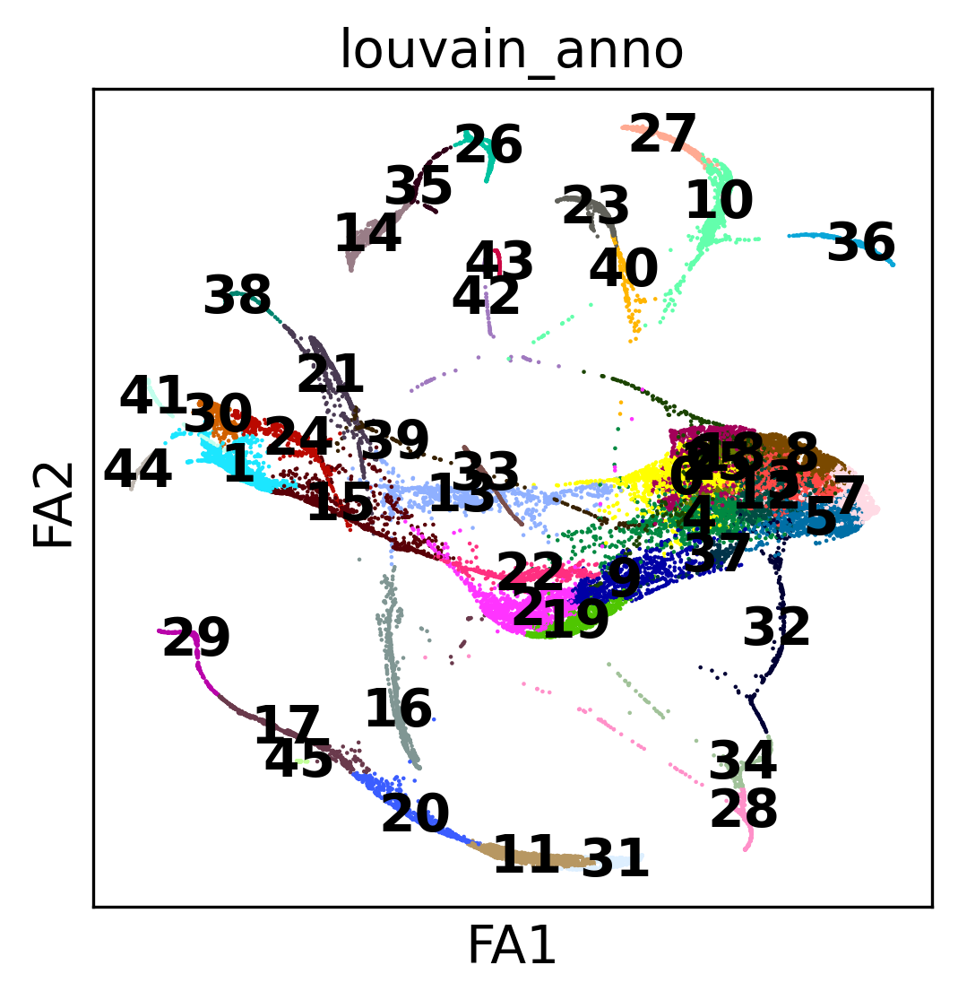

In [138]:
sc.pl.draw_graph(adata, color=['louvain_anno', ], legend_loc='on data', save="____.png")

Choose the colors of the clusters a bit more consistently.

In [139]:
cp -r ./figures/ /content/drive/MyDrive/SC/SCANPY/figures/colab/

In [140]:
import matplotlib.pyplot as pl


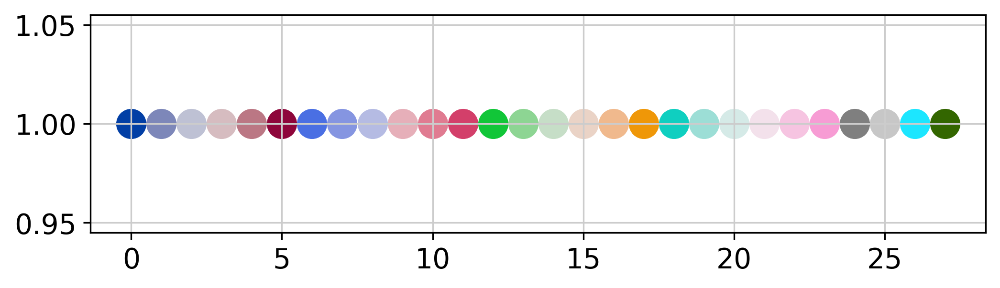

In [141]:
pl.figure(figsize=(8, 2))
for i in range(28):
    pl.scatter(i, 1, c=sc.pl.palettes.zeileis_28[i], s=200)
pl.show()

In [142]:
zeileis_colors = np.array(sc.pl.palettes.zeileis_28)
new_colors = np.array(adata.uns['louvain_anno_colors'])

In [143]:
new_colors[[16]] = zeileis_colors[[12]]  # Stem colors / green
new_colors[[10, 17, 5, 3, 15, 6, 18, 13, 7, 12]] = zeileis_colors[[5, 5, 5, 5, 11, 11, 10, 9, 21, 21]]  # Ery colors / red
new_colors[[20, 8]] = zeileis_colors[[17, 16]]  # Mk early Ery colors / yellow
new_colors[[4, 0]] = zeileis_colors[[2, 8]]  # lymph progenitors / grey
new_colors[[22]] = zeileis_colors[[18]]  # Baso / turquoise
new_colors[[19, 14, 2]] = zeileis_colors[[6, 6, 6]]  # Neu / light blue
new_colors[[24, 9, 1, 11]] = zeileis_colors[[0, 0, 0, 0]]  # Mo / dark blue
new_colors[[21, 23]] = zeileis_colors[[25, 25]]  # outliers / grey

In [144]:
adata.uns['louvain_anno_colors'] = new_colors

And add some white space to some cluster names. The layout shown here differs from the one in the paper, which can be found here. These differences, however, are only cosmetic. We had to change the layout as we moved from a randomized PCA and float32 to float64 precision.

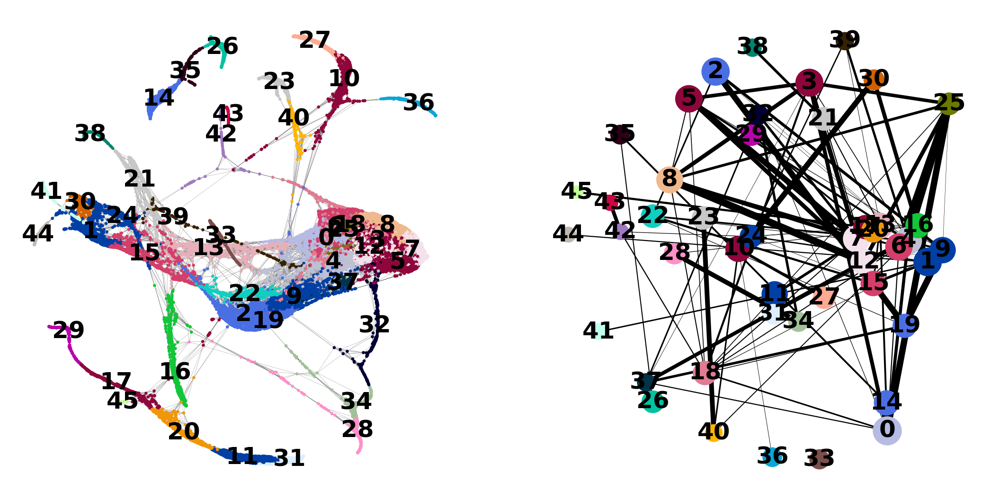

In [145]:
sc.pl.paga_compare(
    adata, threshold=0.03, title='', right_margin=0.2, size=10, edge_width_scale=0.5,
    legend_fontsize=12, fontsize=12, frameon=False, edges=True, save=True)

Reconstructing gene changes along PAGA paths for a given set of genes

In [146]:
adata.uns['iroot'] = np.flatnonzero(adata.obs['louvain_anno']  == '36')[0]

In [147]:
sc.tl.dpt(adata)

computing Diffusion Pseudotime using n_dcs=10
    finished (0:00:00)


Select some of the marker gene names.

In [148]:
gene_names = ['Gata2', 'Gata1', 'Klf1', 'Epor', 'Hba-a2',  # erythroid
              'Elane', 'Cebpe', 'Gfi1',                    # neutrophil
              'Irf8', 'Csf1r', 'Ctsg']      

In [149]:
adata_raw = sc.datasets.paul15()
sc.pp.log1p(adata_raw)
sc.pp.scale(adata_raw)
adata.raw = adata_raw

... storing 'paul15_clusters' as categorical
Trying to set attribute `.uns` of view, copying.


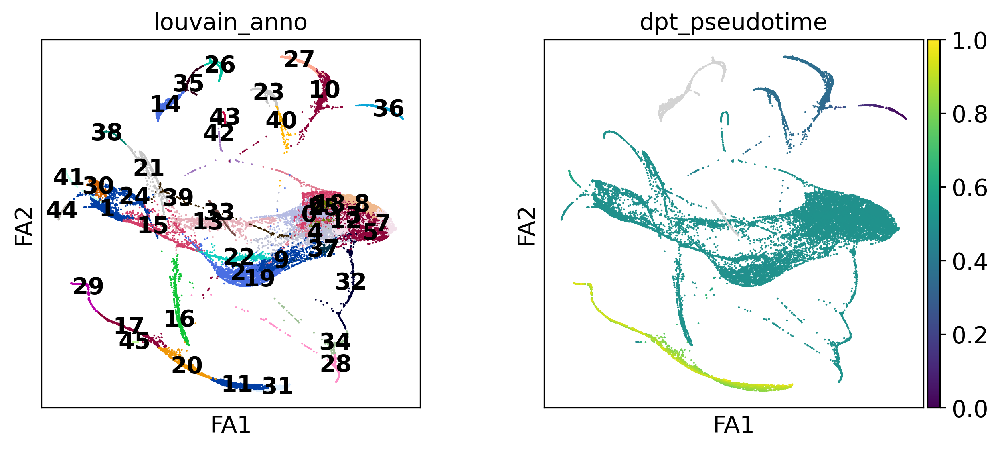

In [150]:
sc.pl.draw_graph(adata, color=['louvain_anno', 'dpt_pseudotime'], legend_loc='on data')

In [151]:
paths = [('erythrocytes', [36, 12, 7, 13, 18, 6, 5, 10]),
         ('neutrophils', [36, 0, 4, 2, 14, 19]),
         ('monocytes', [36, 0, 4, 11, 1, 9, 24])]

In [152]:
adata.obs['distance'] = adata.obs['dpt_pseudotime']

In [153]:
adata.obs['clusters'] = adata.obs['louvain_anno']  # just a cosmetic change

In [154]:
adata.uns['clusters_colors'] = adata.uns['louvain_anno_colors']

IndexError: ignored

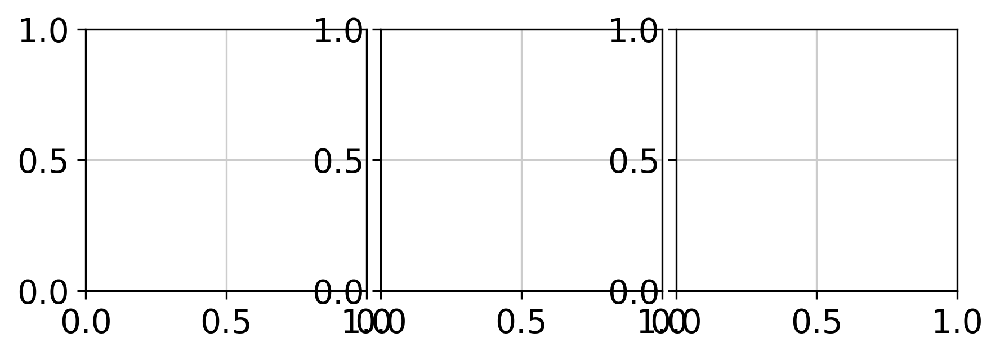

In [155]:
_, axs = pl.subplots(ncols=3, figsize=(6, 2.5), gridspec_kw={'wspace': 0.05, 'left': 0.12})
pl.subplots_adjust(left=0.05, right=0.98, top=0.82, bottom=0.2)
for ipath, (descr, path) in enumerate(paths):
    _, data = sc.pl.paga_path(
        adata, path, gene_names,
        show_node_names=False,
        ax=axs[ipath],
        ytick_fontsize=12,
        left_margin=0.15,
        n_avg=50,
        annotations=['distance'],
        show_yticks=True if ipath==0 else False,
        show_colorbar=False,
        color_map='Greys',
        groups_key='clusters',
        color_maps_annotations={'distance': 'viridis'},
        title='{} path'.format(descr),
        return_data=True, show=True)
    data.to_csv('./write/paga_path_{}.csv'.format(descr))
pl.savefig('./figures/paga_path_paul15.pdf')
pl.show()

In [ ]:
ax = sc.pl.heatmap(pbmc, marker_genes_dict, groupby='clusters', layer='scaled', vmin=-2, vmax=2, cmap='RdBu_r', dendrogram=True, swap_axes=True, figsize=(11,4))

In [ ]:
cp -r ./figures/ /content/drive/MyDrive/SC/SCANPY/figures/colab/